# ATAC annotation using Scanpy

In [1]:
import scanpy as sc
import anndata as ad
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import scipy as sp

from matplotlib import colors

import os
import anndata

In [2]:
sc.logging.print_header()

scanpy==1.7.2 anndata==0.7.6 umap==0.5.1 numpy==1.20.3 scipy==1.7.1 pandas==1.2.5 scikit-learn==0.24.2 statsmodels==0.12.2 python-igraph==0.9.6 louvain==0.7.0


In [3]:
sc.set_figure_params(scanpy=True, dpi=80, dpi_save=250,
                     frameon=False,
                     color_map="YlGnBu", format='pdf', transparent=False,
                    ipython_format='png2x', figsize=(8,8))

In [4]:
#Define a nice colour map for gene expression
colors2 = plt.cm.Reds(np.linspace(0, 1, 128))
colors3 = plt.cm.Greys_r(np.linspace(0.7,0.8,3))
colorsComb = np.vstack([colors3, colors2])
mymap = colors.LinearSegmentedColormap.from_list('my_colormap', colorsComb)

In [5]:
os.getcwd()

'/home/jovyan'

In [6]:
os.chdir('project/proc_data/s2d1/')

## Load data

In [7]:
# Load data preprocessed with Signac
adata_atac = sc.read_h5ad('adata_geneAct.h5ad')

In [8]:
adata_atac

AnnData object with n_obs × n_vars = 5454 × 19039
    obs: 'nCount_peaks', 'atac_fragments', 'TSS.enrichment', 'reads_in_peaks_frac', 'blacklist_fraction', 'nucleosome_signal'
    uns: 'peak_names'
    obsm: 'lsi_full', 'lsi_red', 'peaks', 'umap'

**ATAC Marker genes**

In [9]:
marker_genes = {
    'CD14+ Mono': ['TREM1', 'FPR1'],
    'CD16+ Mono': ['LYN', 'TCF7L2'],
    'ID2-hi myeloid prog': ['KLF4'],
    'cDC2': ['TREM1', 'DMXL2'], # Note: DMXL2 should be negative
    'Normoblast': ['GATA1', 'HBA1', 'SLC4A1', 'SLC25A37', 'KLF1'],
    'Erythroblast': ['GATA1', 'MKI67'],
    'Proerythroblast': ['GATA2','SYNGR1'],
    'NK': ['CD160', 'GNLY', 'GRIK4', 'CD247'],
    'ILC': ['SPON2', 'GZMB', 'PRF1'], # Note CD69 should be negative
    'Lymph prog': ['MME', 'IGLL1', 'VPREB1', 'CD79B'],
    'Naive CD20+ B': ['MS4A1', 'LYN', 'CD74', 'BLK'],
    'B1 B': ['ITGB1', 'MS4A1', 'DUSP22', 'EPHA4'],
    'Transitional B': ['MME', 'CD38', 'CD24'],
    'Plasma cells': ['DUSP22', 'FNDC3B'],
    'CD4+ T activated': ['JAKMIP1', 'C4orf50'],
    'CD4+ T naive': [ 'BCL11B', 'BACH2', 'JAKMIP1', 'C4orf50'], # Note JAKMIP1 and C4orf50 are negative markers
    'CD8+ T': ['CD8A', 'CD8B'],
    'pDCs': ['PTPRS', 'TCF4', 'KCNN3', 'DUSP22'],
    'G/M prog': ['MPO','NT5DC3'],
    'HSC': ['PRDM16','MTRNR2L1'],
    'MK/E prog': ['DNAJC6']
}

# Due to the QC and thresholding issue, some marker genes were filtered out. We're keeping notes here for further usage.
# Proerythroblasts : CRACD
# HSC : TAMALIN
# ILC : C69 (negative marker)


## Clustering

Choose the reduced set of LSI components stored in adata.obsm.lsi_red and cluster on various resolutions.

In [10]:
sc.pp.neighbors(adata_atac, use_rep = 'lsi_red')

In [11]:
sc.tl.leiden(adata_atac, resolution=0.3, key_added='leiden_res0.3')
sc.tl.leiden(adata_atac, resolution=0.5, key_added='leiden_res0.5')
sc.tl.leiden(adata_atac, resolution=0.8, key_added='leiden_res0.8')
sc.tl.leiden(adata_atac, resolution=1, key_added='leiden_res1')

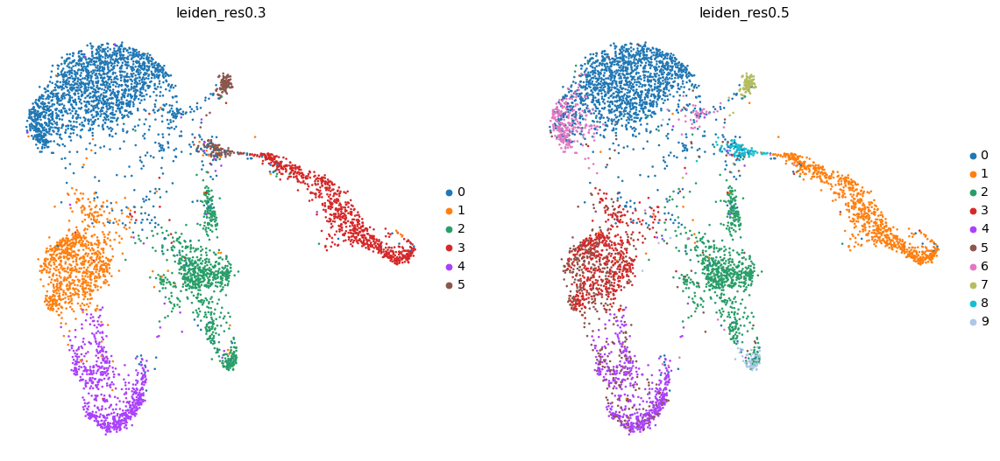

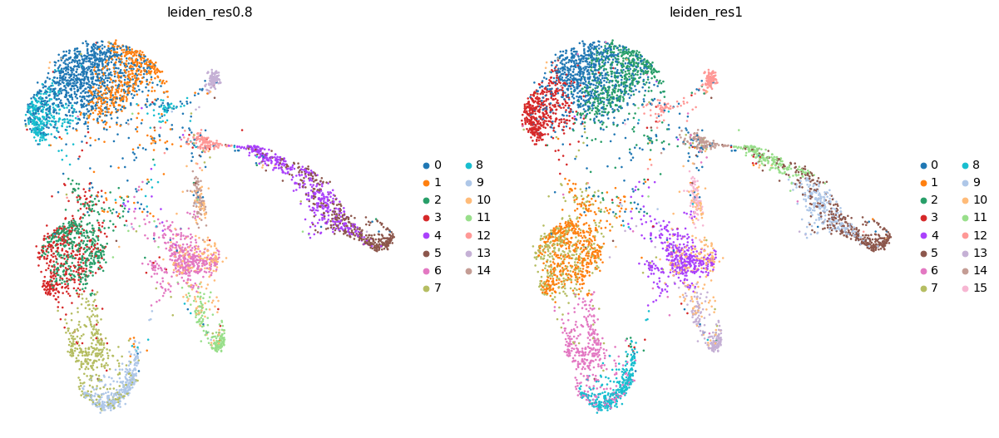

In [12]:
sc.pl.umap(adata_atac, color=['leiden_res0.3', 'leiden_res0.5'])
sc.pl.umap(adata_atac, color=['leiden_res0.8', 'leiden_res1'])

Choose rather coarse resolution that captures the main clusters (here: 0.5)

## QC and marker gene overview

In [13]:
# Select column that should be visualized
leiden_clus_col = 'leiden_res0.5'
# Name for added ranked genes per group
rank_id = 'rank_genes_res0.5'

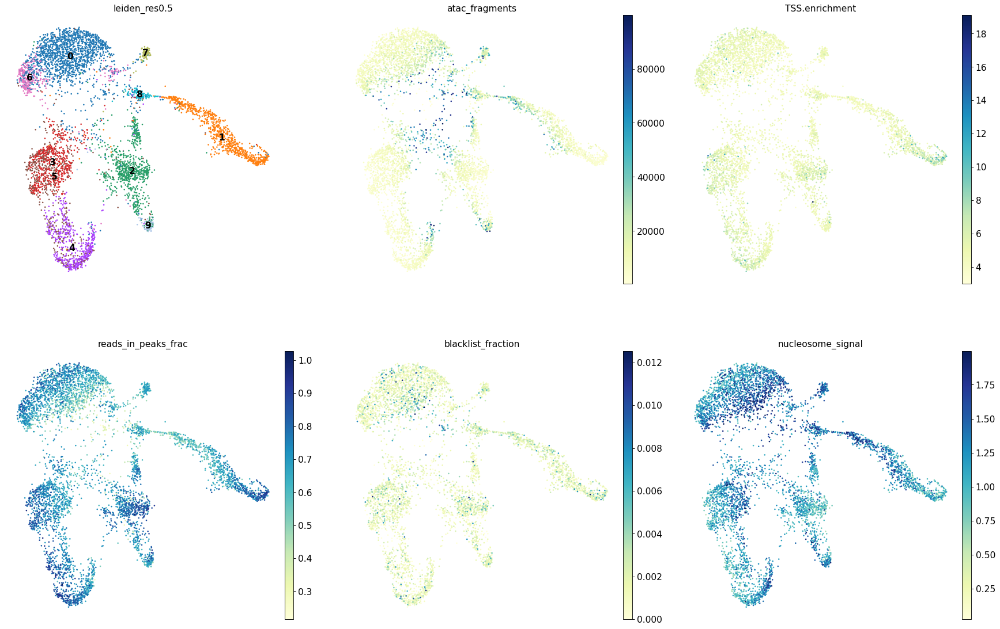

In [14]:
sc.pl.umap(adata_atac, color=[leiden_clus_col, 'atac_fragments', 'TSS.enrichment',
                              'reads_in_peaks_frac','blacklist_fraction','nucleosome_signal'],
          legend_loc = 'on data',
          ncols=3)

In [15]:
sc.tl.rank_genes_groups(adata_atac,
                        groupby= leiden_clus_col,
                        key_added = rank_id)

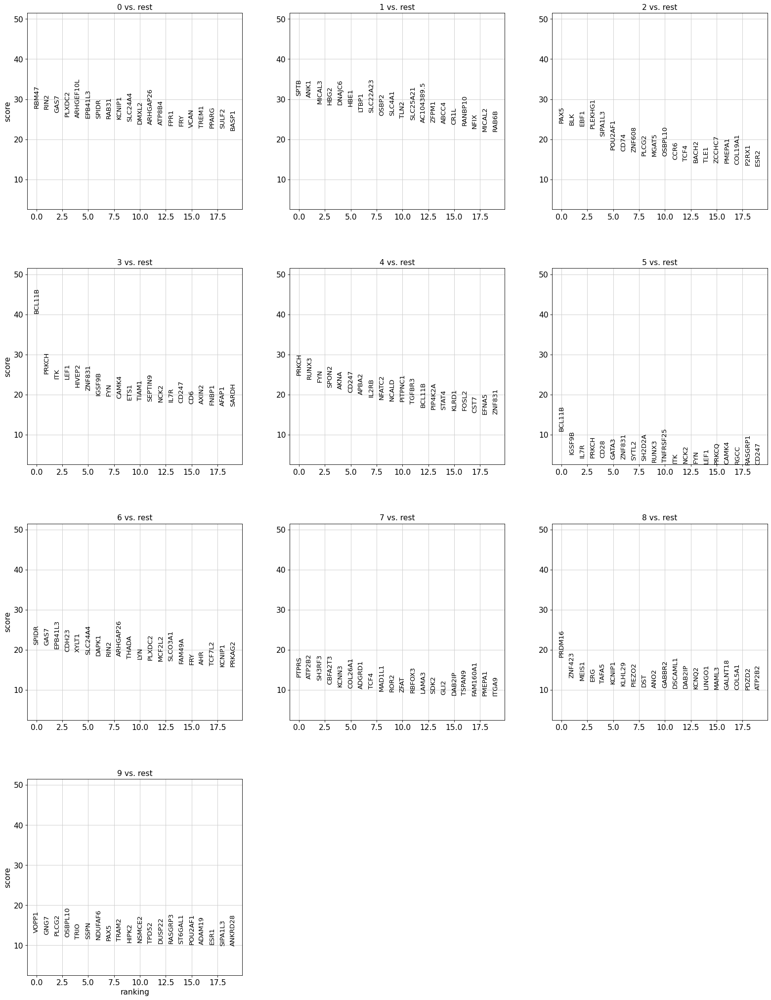

In [16]:
sc.pl.rank_genes_groups(adata_atac, key = rank_id, ncols=3, fontsize=12)

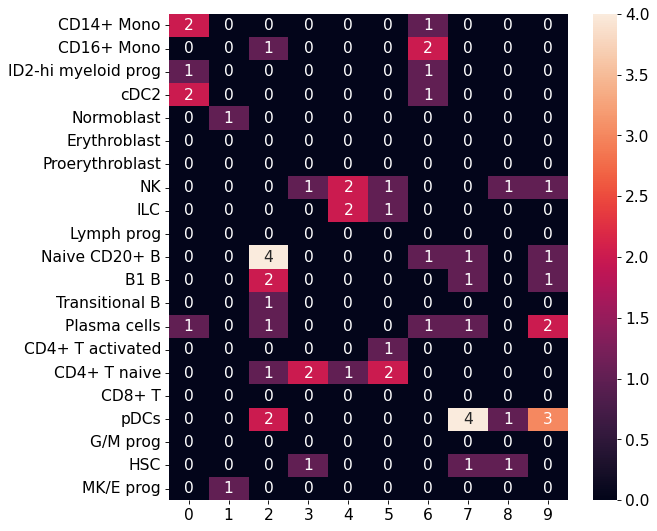

In [17]:
sns.heatmap(sc.tl.marker_gene_overlap(adata_atac,
                                      reference_markers=marker_genes,
                                      key= rank_id), annot=True)

plt.show()

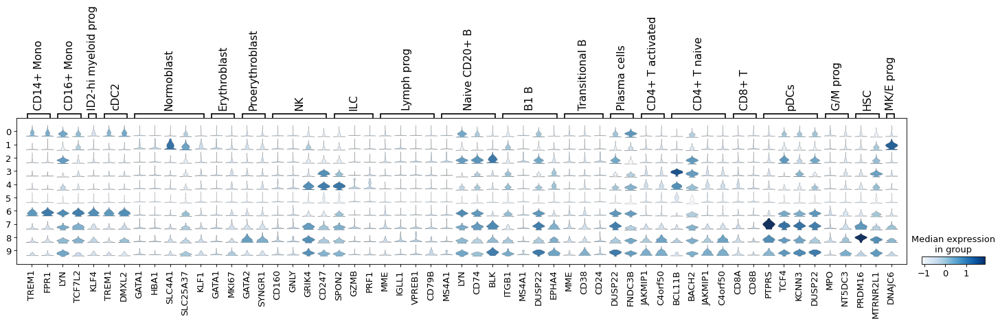

In [18]:
# Reduce to marker genes in gene activity matrix
filt_marker_genes = dict()
for key,val in marker_genes.items():
    filt_vals = [i for i in val if i in adata_atac.var_names]
    filt_marker_genes[key] = filt_vals

# Scale and plot
adata_plot = adata_atac.copy()
sc.pp.scale(adata_plot, max_value=5)
    
sc.pl.stacked_violin(adata_plot, var_names = filt_marker_genes,
                     groupby= leiden_clus_col,
                     use_raw=False)

In [19]:
marker_genes.keys()

dict_keys(['CD14+ Mono', 'CD16+ Mono', 'ID2-hi myeloid prog', 'cDC2', 'Normoblast', 'Erythroblast', 'Proerythroblast', 'NK', 'ILC', 'Lymph prog', 'Naive CD20+ B', 'B1 B', 'Transitional B', 'Plasma cells', 'CD4+ T activated', 'CD4+ T naive', 'CD8+ T', 'pDCs', 'G/M prog', 'HSC', 'MK/E prog'])

In [20]:
# Initial clustering:

init_clus_dict = {
    
    '0':['CD 14+ Mono','CD 16+ Mono','ID2-hi myeloid prog'],
    '1':['Normoblast'],
    '2':['Naive CD20+ B','B1 B'],
    '3':['CD4+ T naive'],
    '4':['NK', 'ILC' ],
    '5':['CD4+ T naive','CD4+ T activated'],
    '6':['CD16+ Mono','cDC2'], 
    '7':['pDCs'],
    '8':['HSC'],
    '9':['pDCs','Plasma cells','Transitional B']
}

# This initial clustering is based upon the violin plot above, thus preliminary.

### Plot marker genes

Check whether marker gene expression gives hint to subclusters of initial clusters.

Some marker genes are negative: DMXL2 for cDC2; CD69 for ILCs; JAKMIP1 and C4orf50 for naive T cells.

Due to the sparsity of the ATAC data, increased gene activity is not always very obivios. Try to keep keep clear markers for other celltypes in mind.

Cluster: CD14+ Mono


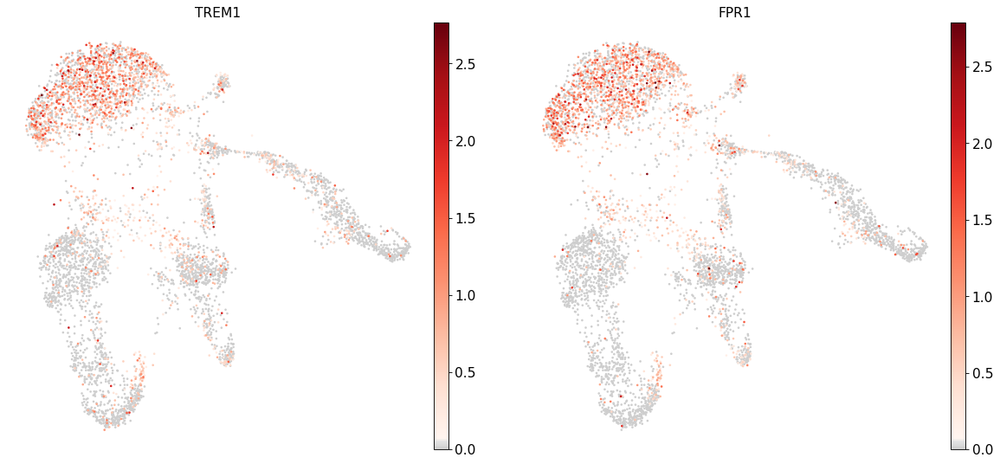

Cluster: CD16+ Mono


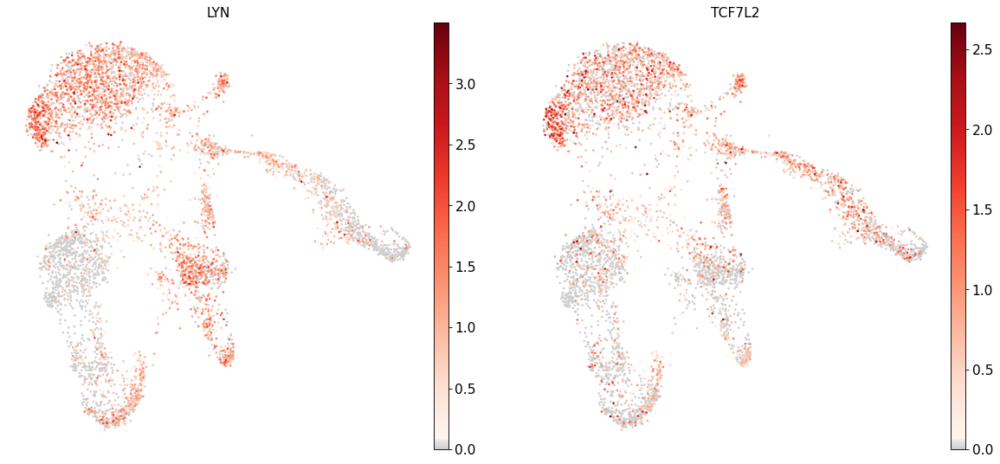

Cluster: ID2-hi myeloid prog


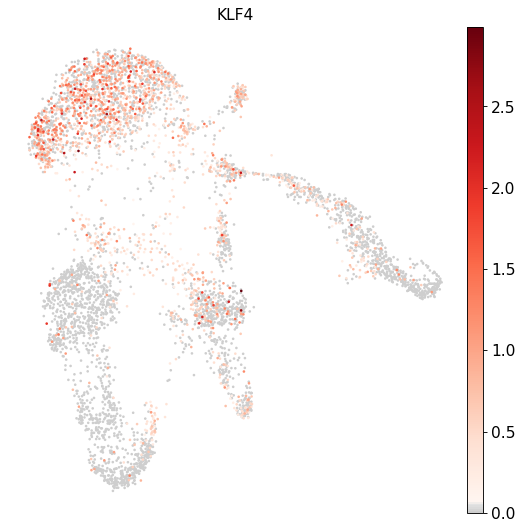

Cluster: cDC2


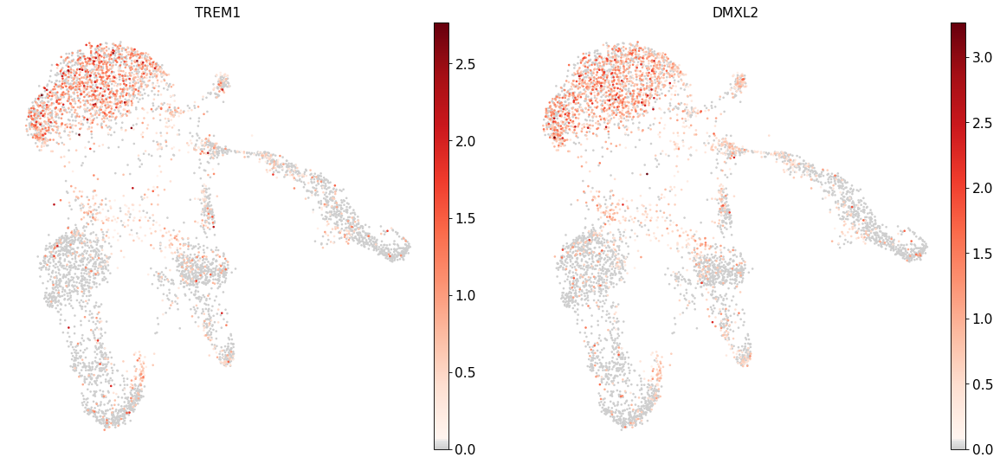

Cluster: Normoblast


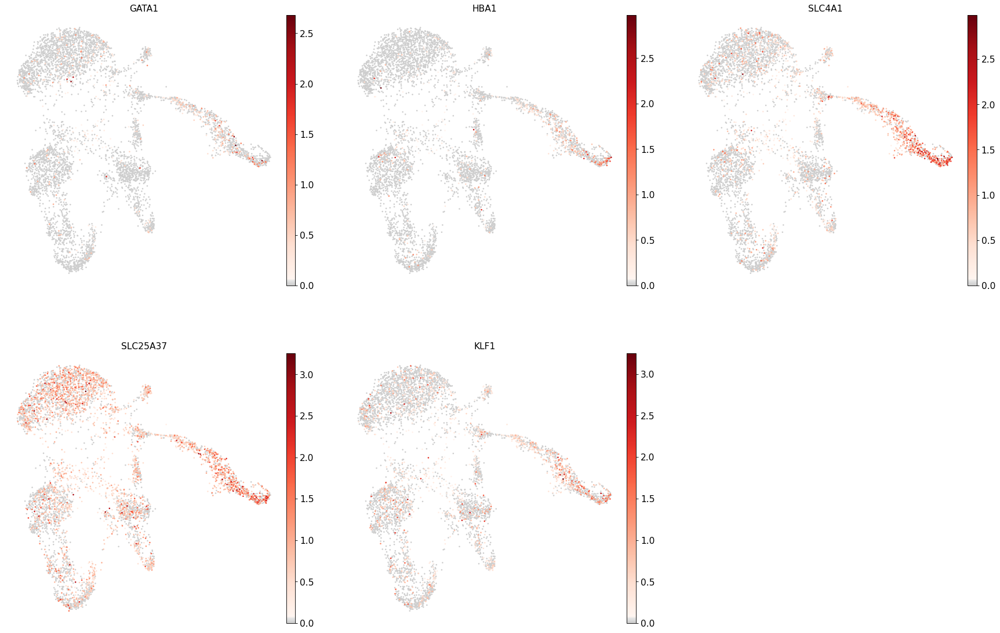

Cluster: Erythroblast


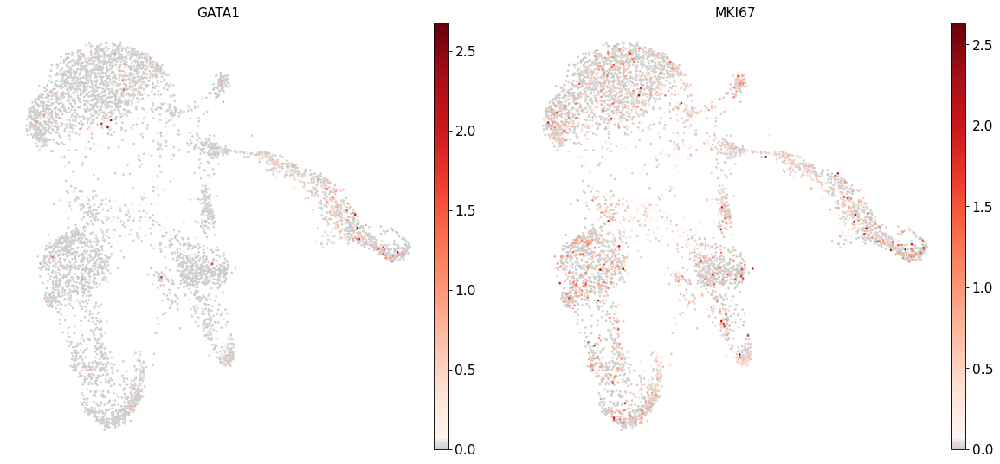

Cluster: Proerythroblast


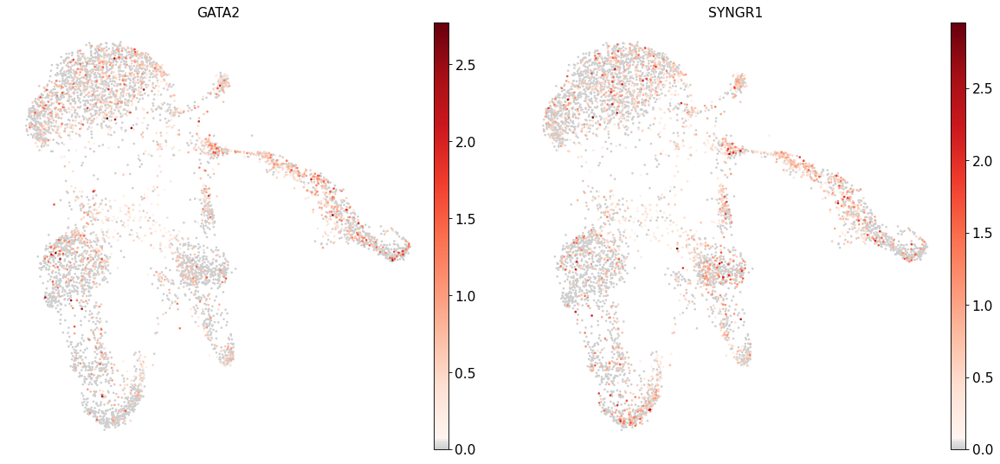

Cluster: NK


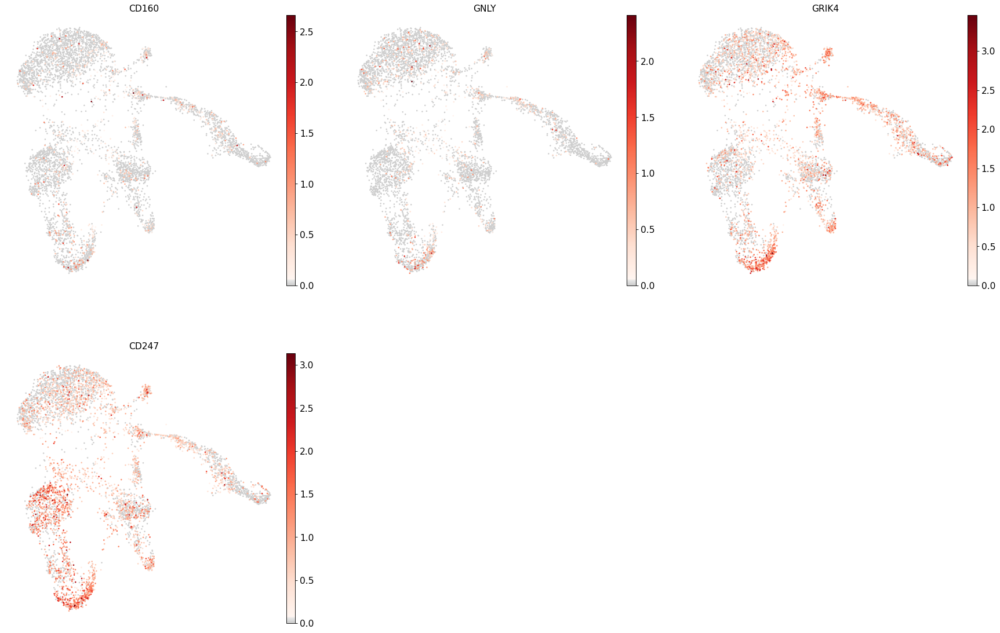

Cluster: ILC


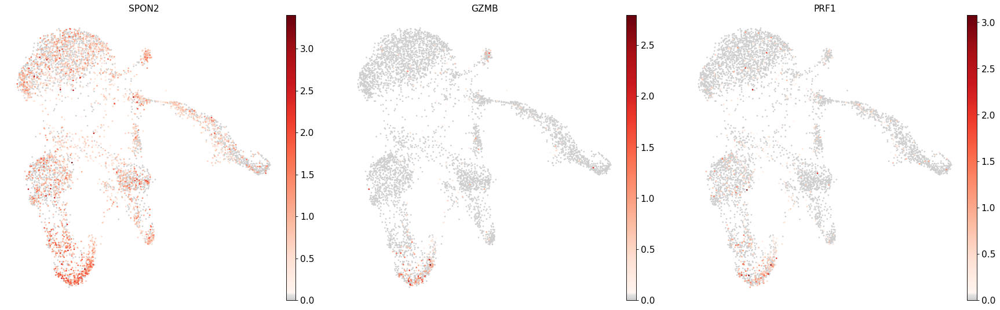

Cluster: Lymph prog


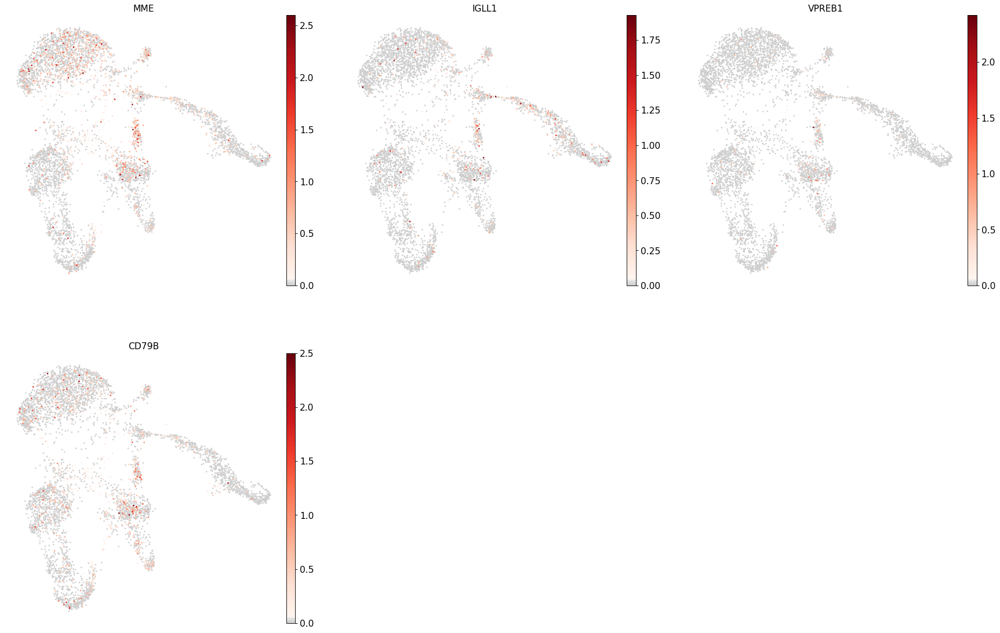

Cluster: Naive CD20+ B


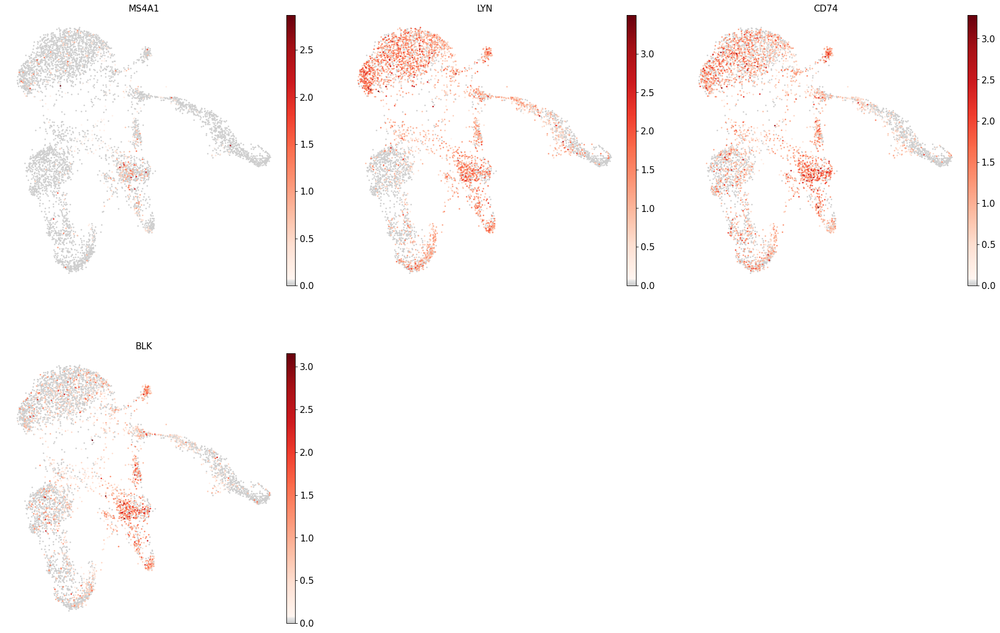

Cluster: B1 B


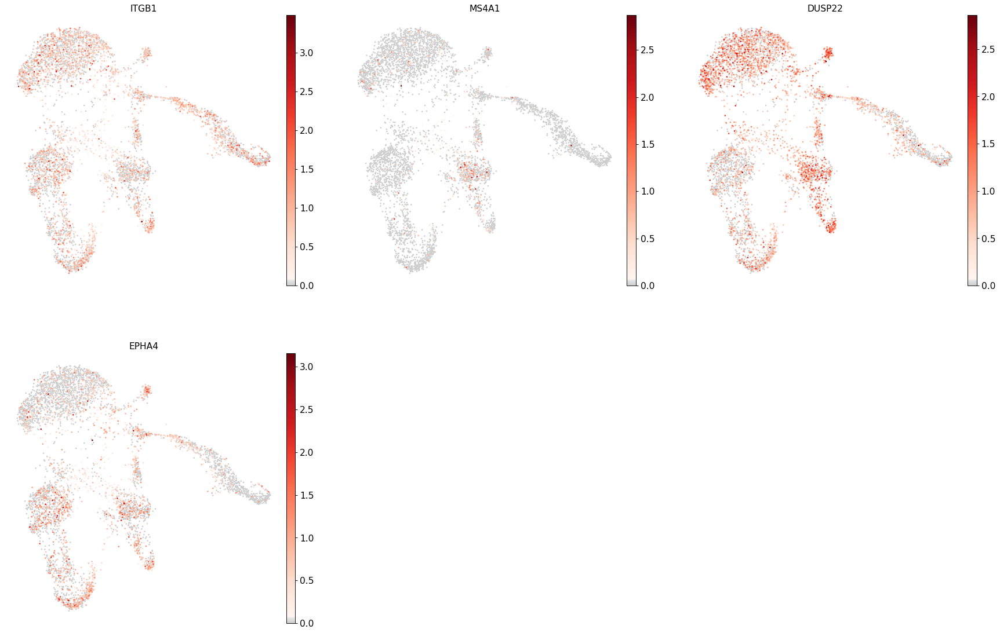

Cluster: Transitional B


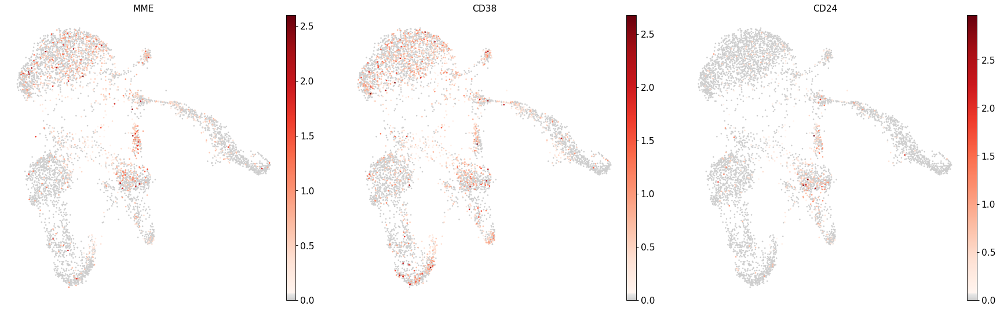

Cluster: Plasma cells


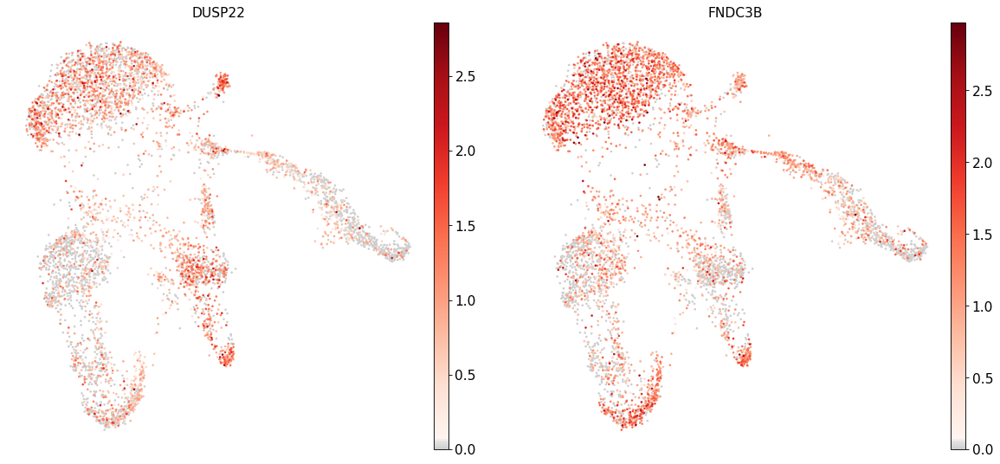

Cluster: CD4+ T activated


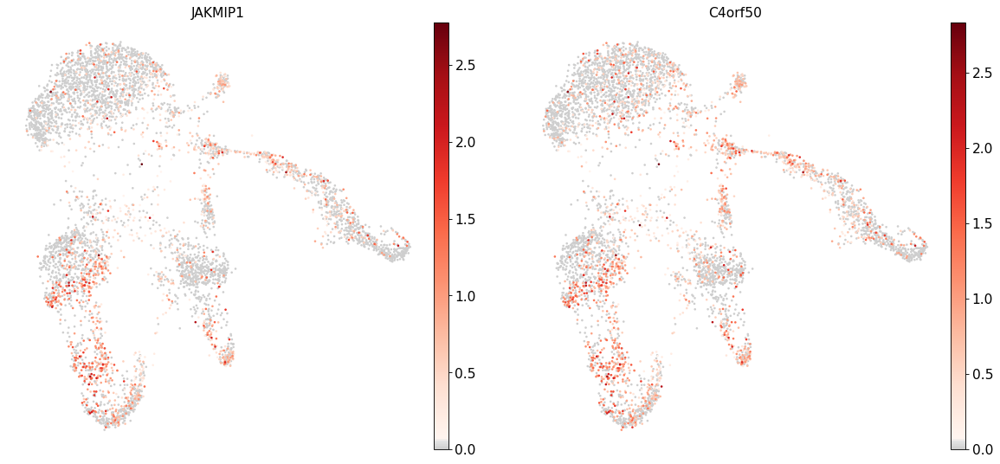

Cluster: CD4+ T naive


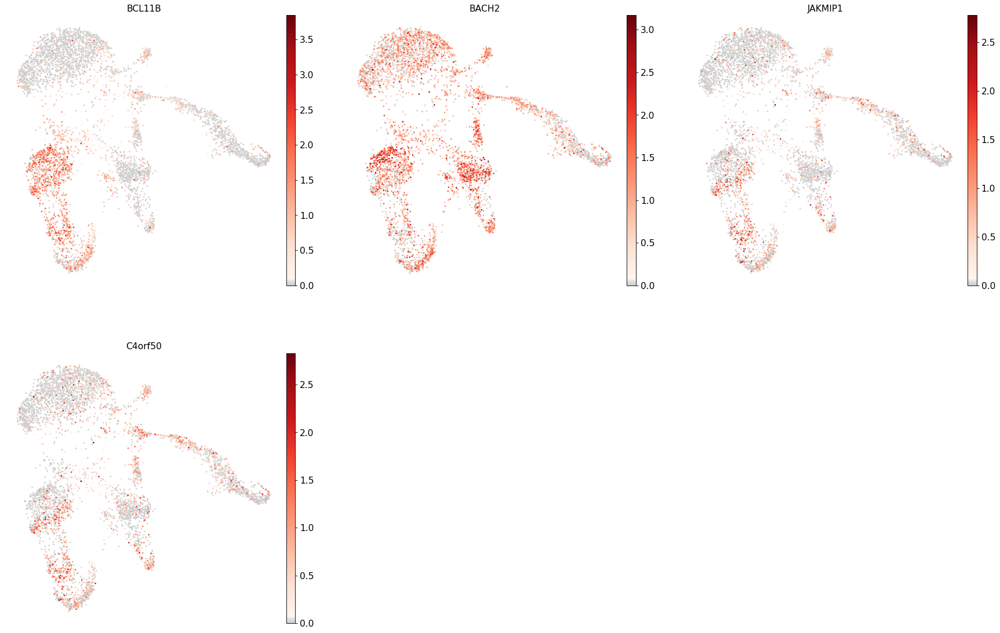

Cluster: CD8+ T


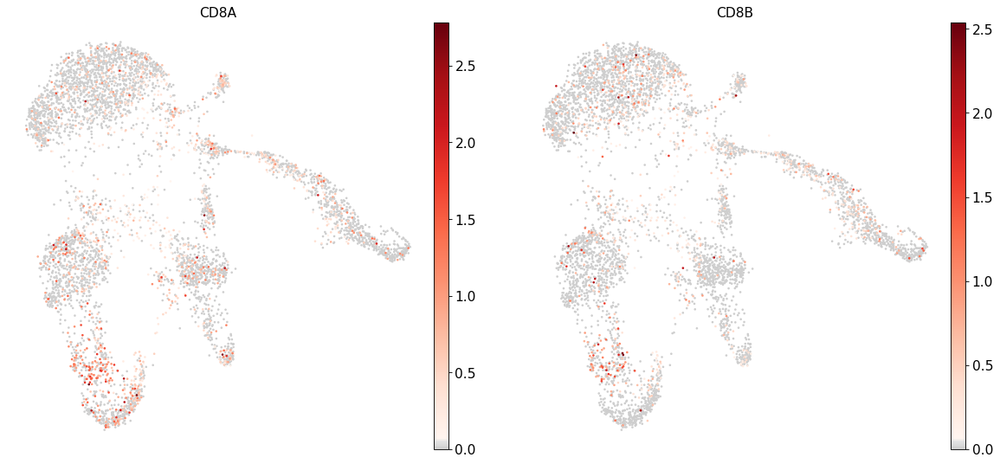

Cluster: pDCs


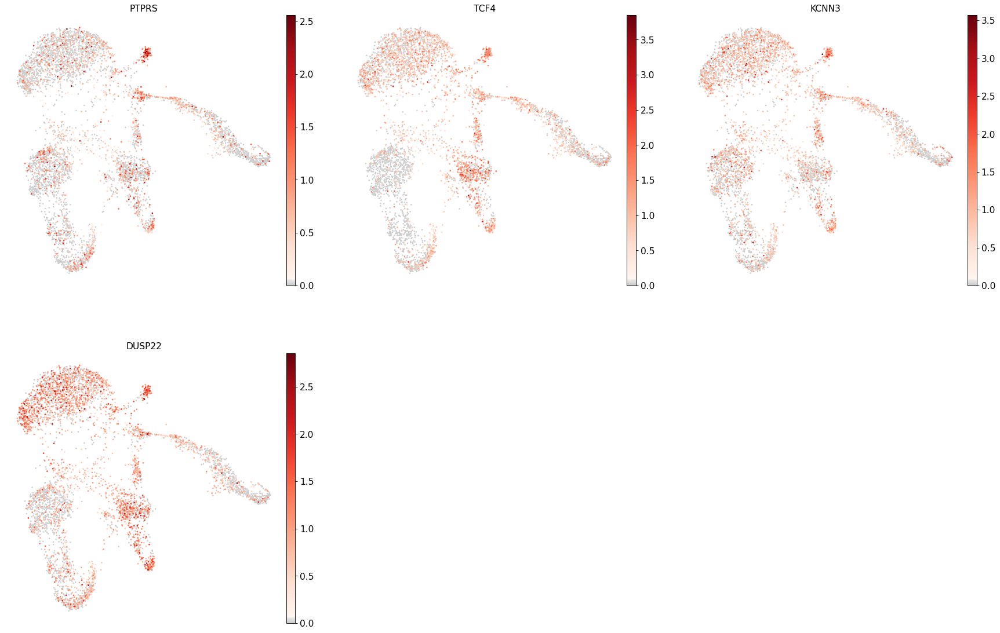

Cluster: G/M prog


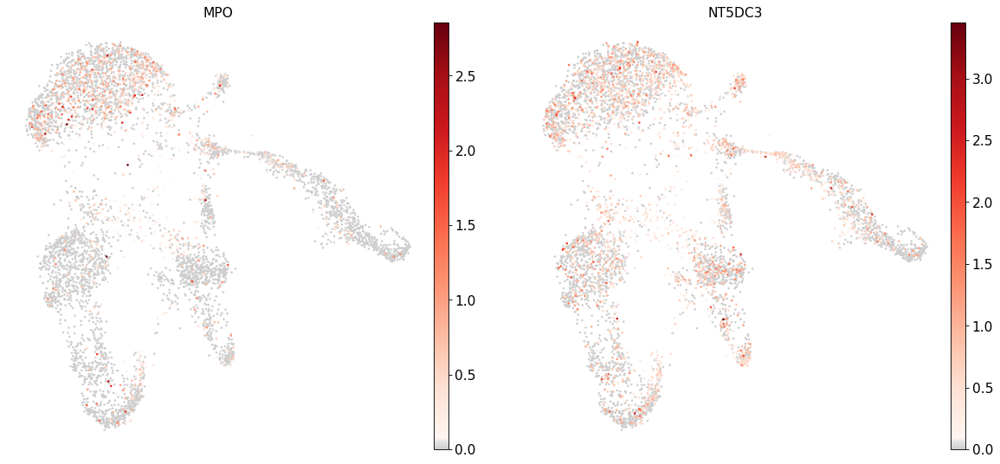

Cluster: HSC


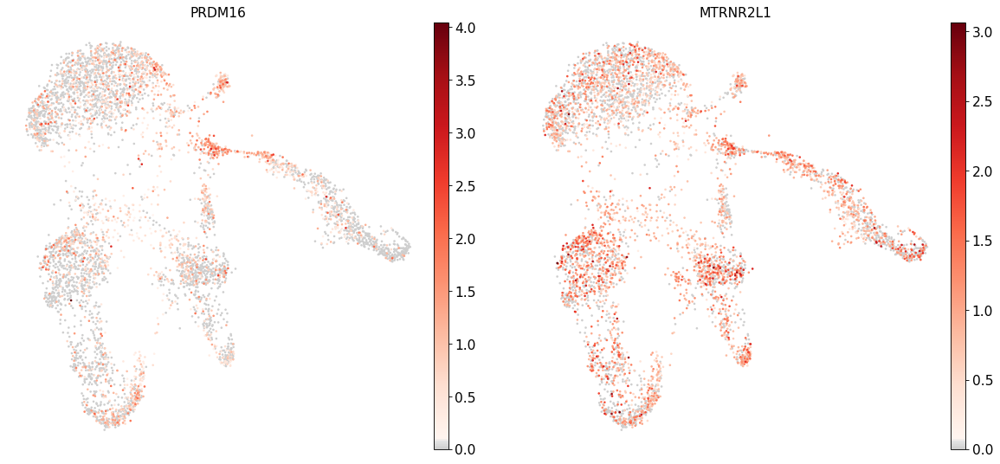

Cluster: MK/E prog


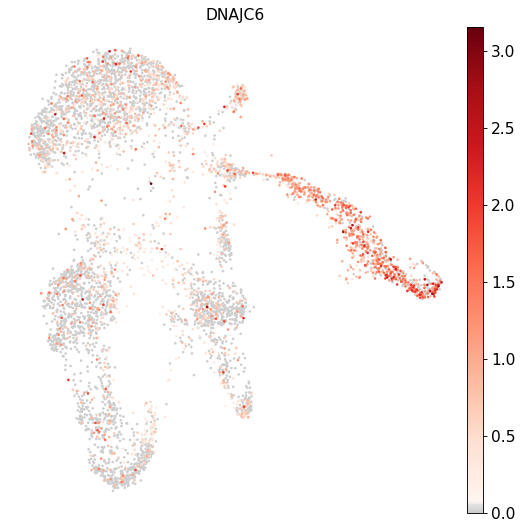

In [21]:
for i in marker_genes.keys():
    print(f'Cluster: {i}')
    genes_to_plot = [i for i in marker_genes[i] if i in adata_atac.var_names]
    sc.pl.umap(adata_atac, color=genes_to_plot, ncols=3, use_raw=False, cmap=mymap)

Marker genes suggest:
- 0: CD 14+ Mono, CD 16+ Mono, ID2-hi myeloid prog, cDC2
- 1: Normoblast, MK/E prog
- 2: Naive CD20+ B, B1 B
- 3: CD4+ T naive
- 4: NK, ILC, CD8+ T
- 5: CD4+ T naive, CD4+ T activated
- 6: CD15+ Mono, cDC2, CD14+ Mono, CD16+ Mono
- 7: pDCs
- 8: HSC
- 9: pDCs, Plamsa cells

Subcluster 
- 0, 6: CD+ Monocytes
- 1: Erythroblast development (possibly 2 and 4 as well)
- 2: B cells (also possibly 6, 9)
- 4: NK/ILC (also possibly CD8+ T)
- 7, 9: pDCs


In [22]:
# Based on the UMAP, we adjusted our initial guess for the cluster identities

# Initial clustering:

init_clus_dict = {
    
    '0':['CD 14+ Mono','CD 16+ Mono','ID2-hi myeloid prog','cDC2'],
    '1':['Normoblast','Proerythroblast','Erythroblast'],
    '2':['Naive CD20+ B','B1 B','Transitional B'],
    '3':['CD4+ T naive'],
    '4':['NK', 'ILC','CD8+ T' ],
    '5':['CD4+ T naive','CD4+ T activated'],
    '6':['CD16+ Mono','cDC2','CD 14+ Mono','CD 16+ Mono','G/M prog'], 
    '7':['pDCs'],
    '8':['HSC'],
    '9':['pDCs','Plasma cells','Transitional B']
}



# Subclustering

Subclustering can be done by considering the marker genes and clustering of clear substructure in the data. Here we go through the clusters based on the major cell types identified above.


## Monocytes and DCs

In [23]:
marker_genes

{'CD14+ Mono': ['TREM1', 'FPR1'],
 'CD16+ Mono': ['LYN', 'TCF7L2'],
 'ID2-hi myeloid prog': ['KLF4'],
 'cDC2': ['TREM1', 'DMXL2'],
 'Normoblast': ['GATA1', 'HBA1', 'SLC4A1', 'SLC25A37', 'KLF1'],
 'Erythroblast': ['GATA1', 'MKI67'],
 'Proerythroblast': ['GATA2', 'SYNGR1'],
 'NK': ['CD160', 'GNLY', 'GRIK4', 'CD247'],
 'ILC': ['SPON2', 'GZMB', 'PRF1'],
 'Lymph prog': ['MME', 'IGLL1', 'VPREB1', 'CD79B'],
 'Naive CD20+ B': ['MS4A1', 'LYN', 'CD74', 'BLK'],
 'B1 B': ['ITGB1', 'MS4A1', 'DUSP22', 'EPHA4'],
 'Transitional B': ['MME', 'CD38', 'CD24'],
 'Plasma cells': ['DUSP22', 'FNDC3B'],
 'CD4+ T activated': ['JAKMIP1', 'C4orf50'],
 'CD4+ T naive': ['BCL11B', 'BACH2', 'JAKMIP1', 'C4orf50'],
 'CD8+ T': ['CD8A', 'CD8B'],
 'pDCs': ['PTPRS', 'TCF4', 'KCNN3', 'DUSP22'],
 'G/M prog': ['MPO', 'NT5DC3'],
 'HSC': ['PRDM16', 'MTRNR2L1'],
 'MK/E prog': ['DNAJC6']}

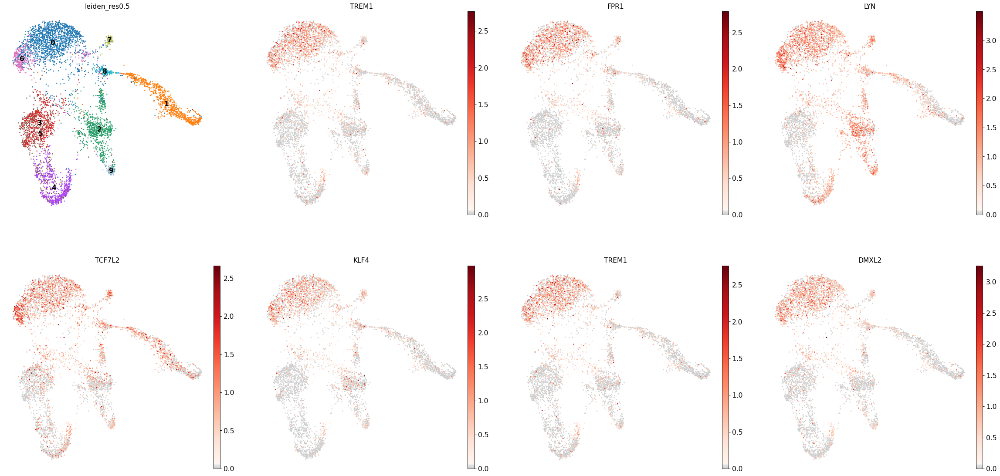

In [24]:
# Replot clusters and marker genes
sc.pl.umap(adata_atac, cmap=mymap, legend_loc = 'on data',
           color = [leiden_clus_col]+
              marker_genes['CD14+ Mono']+
              marker_genes['CD16+ Mono']+
              marker_genes['ID2-hi myeloid prog']+
              marker_genes['cDC2']
          )

### cluster 0

In [25]:
c_id = 0

In [26]:
# Initial assignment
init_clus_dict[str(c_id)]

['CD 14+ Mono', 'CD 16+ Mono', 'ID2-hi myeloid prog', 'cDC2']

Here, we try to split the sub-structures and see whether they have differential accessibility level between sub-structures

For this **first** split, we use the leiden_clus_col as a starting point, for subsequent splits we use the newly generated column to get a final clustering in the end. For testing the correct resolution for each cluster we further work with a temporary cluster column.

In [27]:
# Once the resolution looks good change new_key to leiden final
orig_key = leiden_clus_col
#new_key = 'leiden_temp'
new_key = 'leiden_sub' 
new_rg_key = 'rg_tsub'
sub_key = str(c_id)

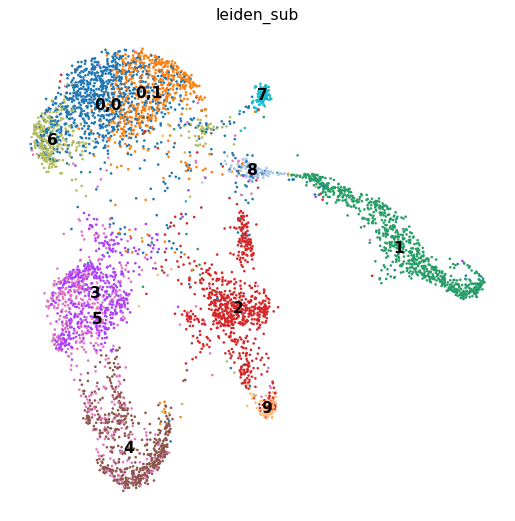

0,0    1056
1       809
2       784
0,1     572
3       551
4       532
5       510
6       332
7       120
8       104
9        84
Name: leiden_sub, dtype: int64

In [28]:
res=0.3
sc.tl.leiden(adata_atac, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata_atac, color=new_key, legend_loc='on data')
adata_atac.obs[new_key].value_counts()


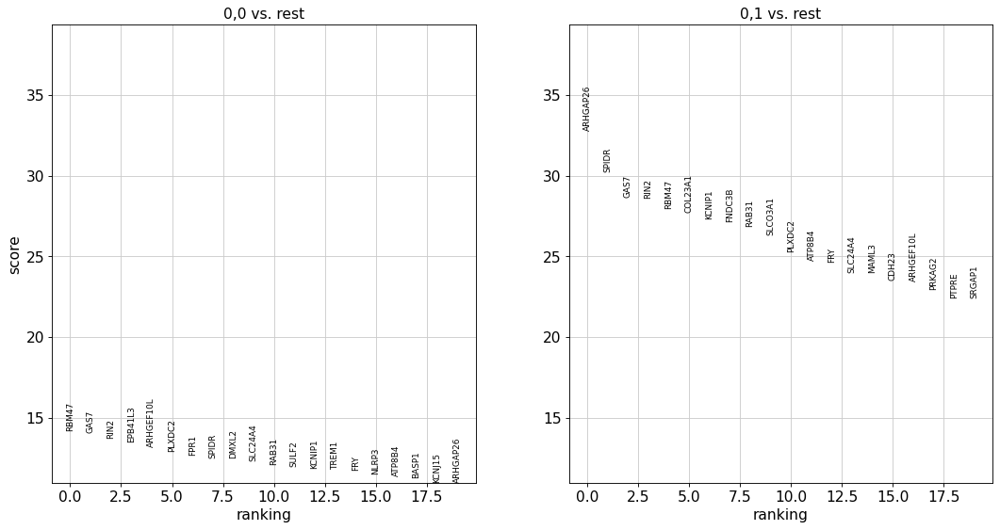

In [29]:
# Check markers of subclusters

#set number of clusters
num_subclusts = 2

new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_atac, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_atac, key=new_rg_key, groups=new_groups, ncols=3)

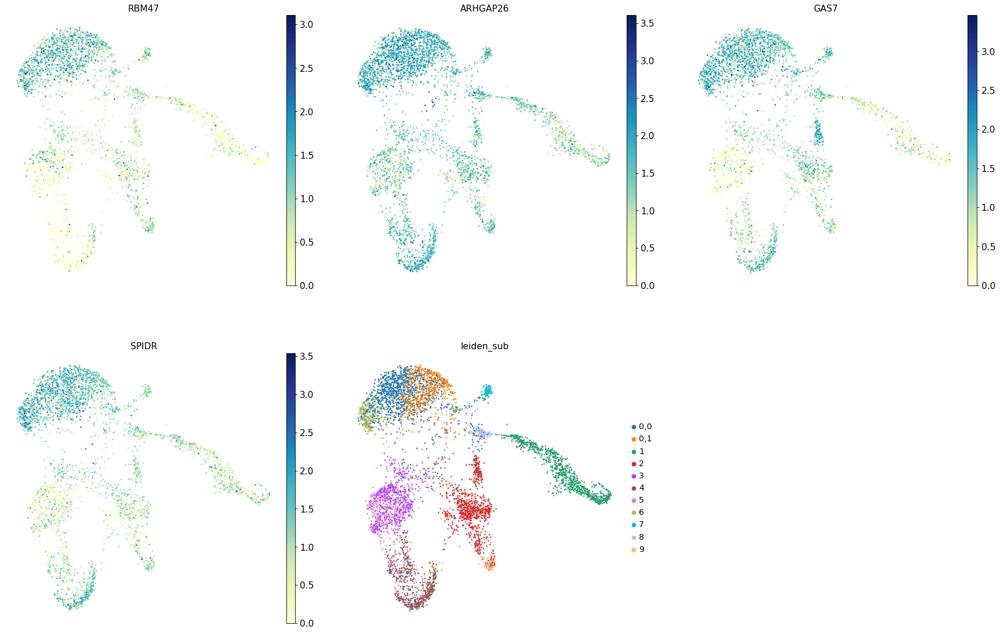

In [30]:
top_2_genes = list(adata_atac.uns[new_rg_key]['names'][0])+list(adata_atac.uns[new_rg_key]['names'][1])
sc.pl.umap(adata_atac, color=top_2_genes+[new_key], ncols=3)

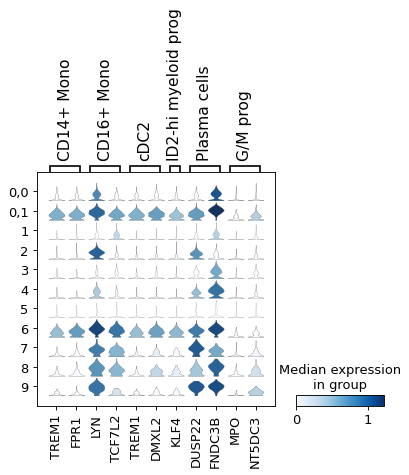

In [31]:
sc.pl.stacked_violin(adata_atac, var_names={a:marker_genes[a] for a in ['CD14+ Mono', 'CD16+ Mono', 'cDC2', 'ID2-hi myeloid prog','Plasma cells','G/M prog']}, groupby=new_key)

#### Conclusion
- 0: CD14+ Mono

### cluster 6

In [32]:
c_id = 6

In [33]:
# Initial assignment
init_clus_dict[str(c_id)]

['CD16+ Mono', 'cDC2', 'CD 14+ Mono', 'CD 16+ Mono', 'G/M prog']

In [34]:
# Once the resolution looks good change new_key to leiden final
orig_key = leiden_clus_col
#new_key = 'leiden_temp'
new_key = 'leiden_sub2' 
new_rg_key = 'rg_tsub2'
sub_key = str(c_id)

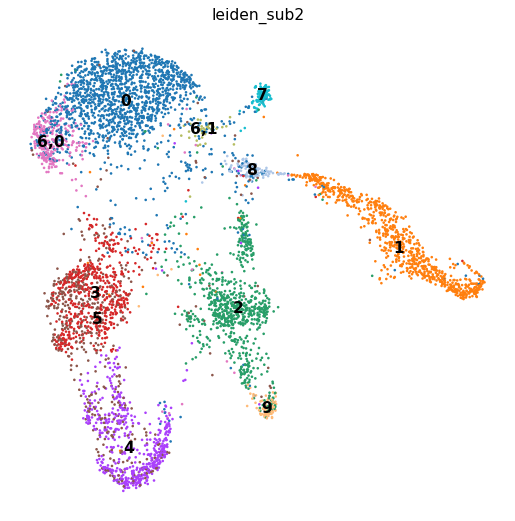

0      1628
1       809
2       784
3       551
4       532
5       510
6,0     293
7       120
8       104
9        84
6,1      39
Name: leiden_sub2, dtype: int64

In [35]:
res=0.3
sc.tl.leiden(adata_atac, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata_atac, color=new_key, legend_loc='on data')
adata_atac.obs[new_key].value_counts()


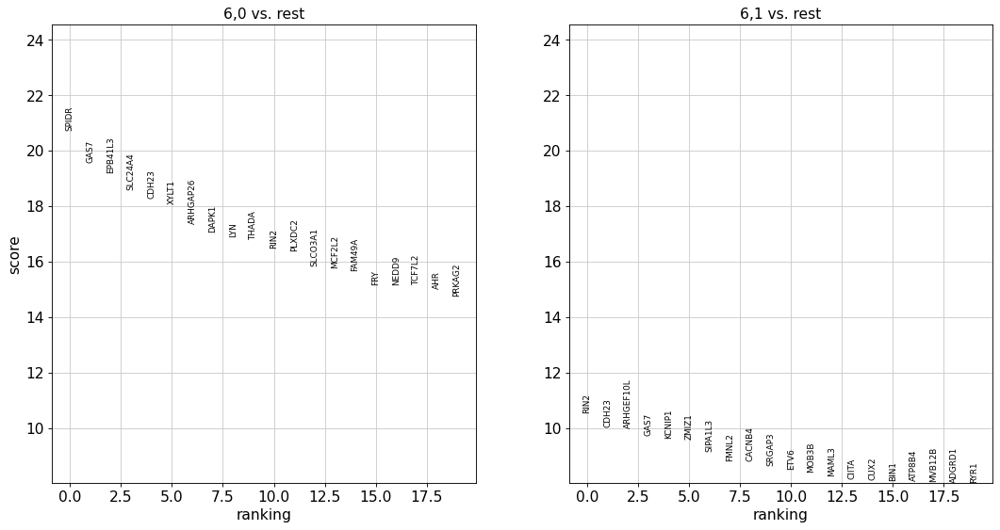

In [36]:
# Check markers of subclusters

#set number of clusters
num_subclusts = 2

new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_atac, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_atac, key=new_rg_key, groups=new_groups, ncols=3)

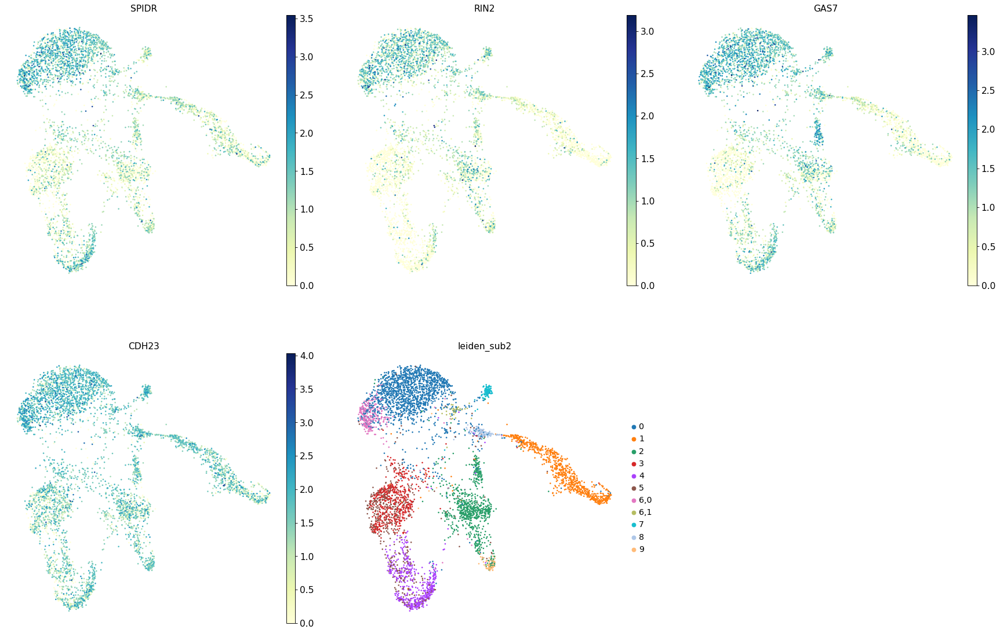

In [37]:
top_2_genes = list(adata_atac.uns[new_rg_key]['names'][0])+list(adata_atac.uns[new_rg_key]['names'][1])
sc.pl.umap(adata_atac, color=top_2_genes+[new_key], ncols=3)

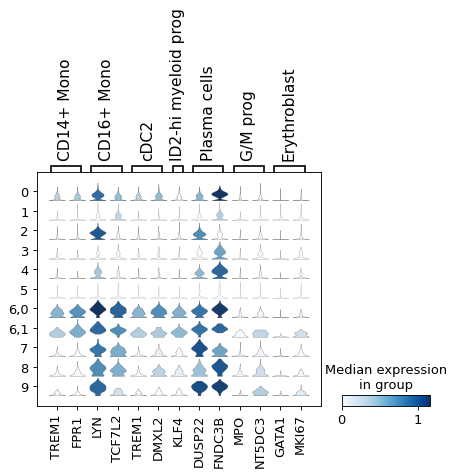

In [38]:
sc.pl.stacked_violin(adata_atac, var_names={a:marker_genes[a] for a in ['CD14+ Mono', 'CD16+ Mono', 'cDC2', 'ID2-hi myeloid prog','Plasma cells','G/M prog', 'Erythroblast']}, groupby=new_key)

#### Conclusion
- 6: CD16+ Mono

## pDCs - cluster 7 and 9

Cluster 7 is very small, and I couldn't see any clear sub-structures, thus we will just assign the cluster 7 to pDCs.

In [39]:
c_id = 9

In [40]:
# Initial assignment
init_clus_dict[str(c_id)]

['pDCs', 'Plasma cells', 'Transitional B']

In [41]:
# Once the resolution looks good change new_key to leiden_sub
orig_key = leiden_clus_col
#new_key = 'leiden_temp'
new_key = 'leiden_res0.5_psub1'
new_rg_key = 'rg_psub1'
sub_key = str(c_id)


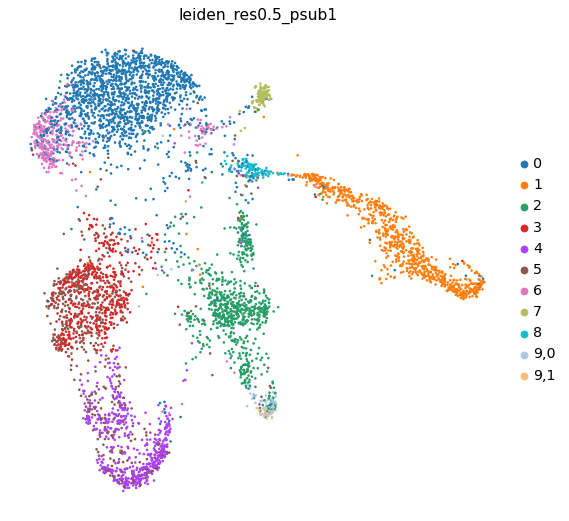

0      1628
1       809
2       784
3       551
4       532
5       510
6       332
7       120
8       104
9,0      63
9,1      21
Name: leiden_res0.5_psub1, dtype: int64

In [42]:
res=0.3
sc.tl.leiden(adata_atac, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata_atac, color=new_key)#, legend_loc='on data')
adata_atac.obs[new_key].value_counts()


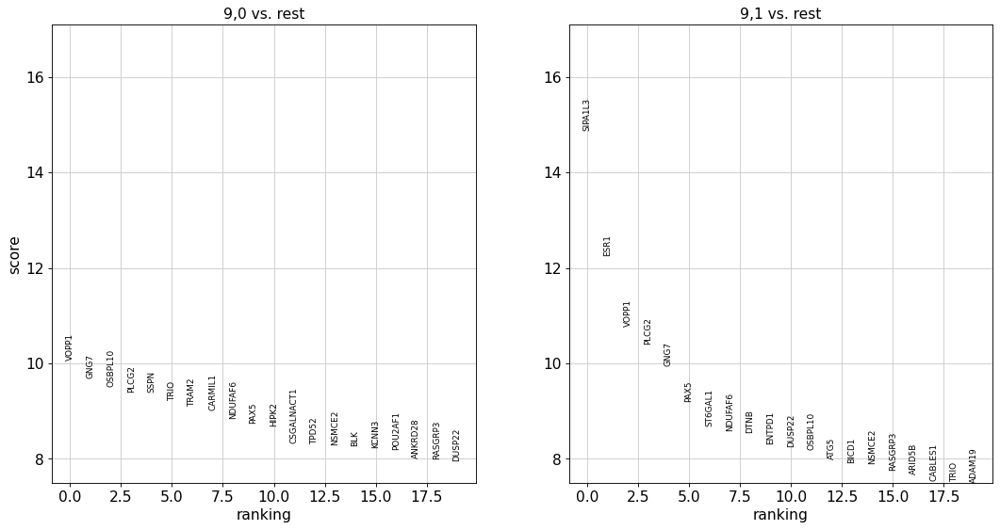

In [43]:
# Check markers of subclusters

#set number of clusters
num_subclusts = 2

new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_atac, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_atac, key=new_rg_key, groups=new_groups, ncols=3)

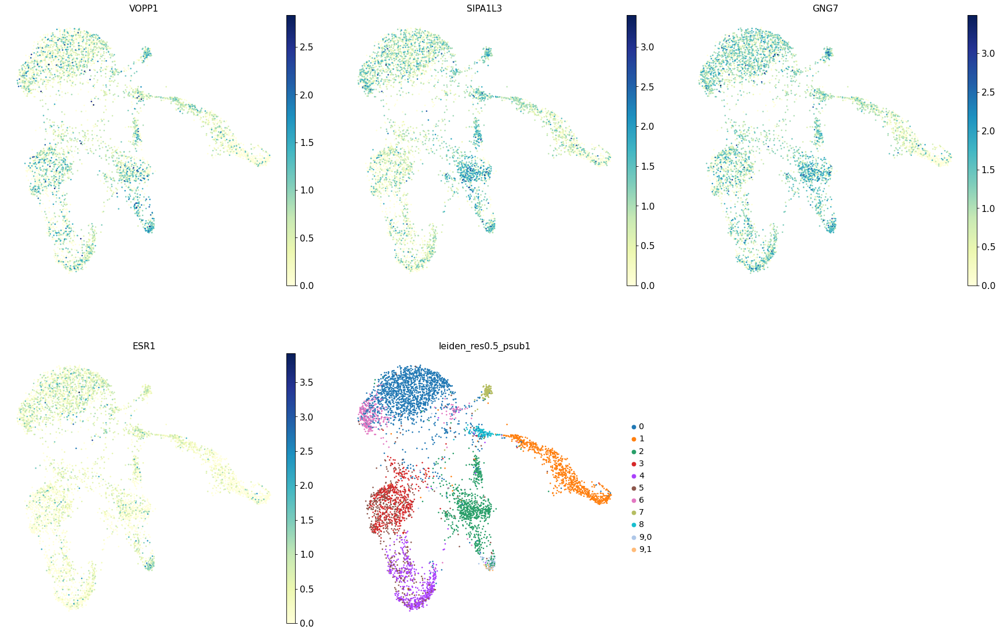

In [44]:
top_2_genes = list(adata_atac.uns[new_rg_key]['names'][0])+list(adata_atac.uns[new_rg_key]['names'][1])
sc.pl.umap(adata_atac, color=top_2_genes+[new_key], ncols=3)

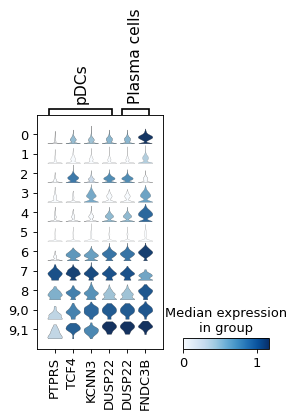

In [45]:
sc.pl.stacked_violin(adata_atac, var_names={a:marker_genes[a] for a in ['pDCs','Plasma cells']}, groupby=new_key)

#### Conclusion

9,0 and 9,1 are very similar, and both show higher expression levels of pDCs compared to other clusters.

- 9: Plasma cells

In [46]:
c_id = 7

In [47]:
# Initial assignment
init_clus_dict[str(c_id)]

['pDCs']

In [48]:
# Once the resolution looks good change new_key to leiden_sub
orig_key = 'leiden_sub2'
#new_key = 'leiden_temp'
new_key = 'leiden_res0.5_psub1'
new_rg_key = 'rg_psub1'
sub_key = str(c_id)


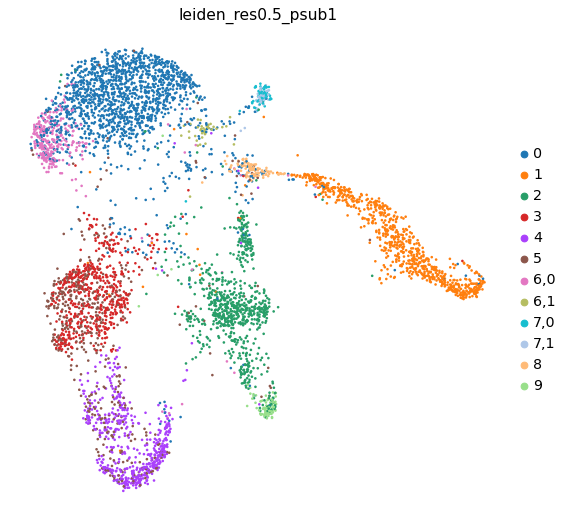

0      1628
1       809
2       784
3       551
4       532
5       510
6,0     293
8       104
9        84
7,0      75
7,1      45
6,1      39
Name: leiden_res0.5_psub1, dtype: int64

In [49]:
res=0.2
sc.tl.leiden(adata_atac, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata_atac, color=new_key)#, legend_loc='on data')
adata_atac.obs[new_key].value_counts()


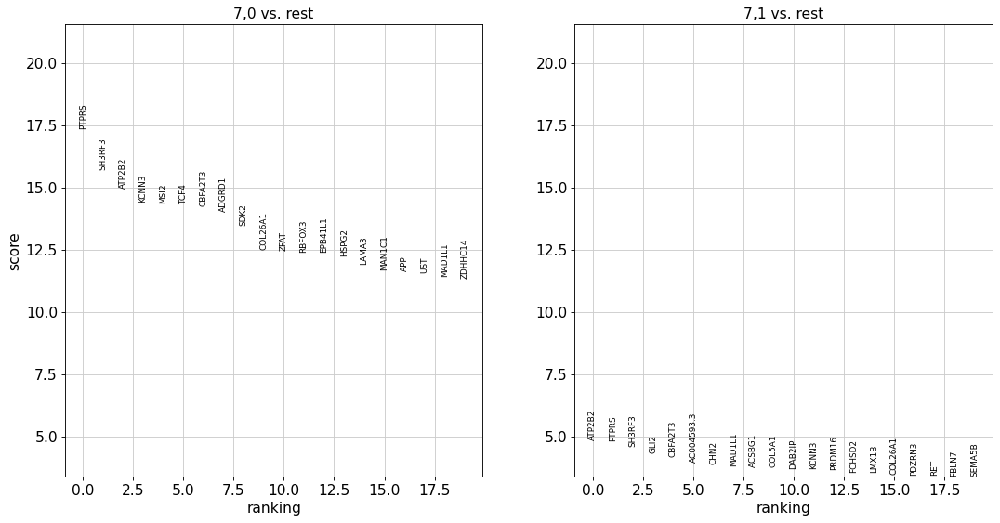

In [50]:
# Check markers of subclusters

#set number of clusters
num_subclusts = 2

new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_atac, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_atac, key=new_rg_key, groups=new_groups, ncols=3)

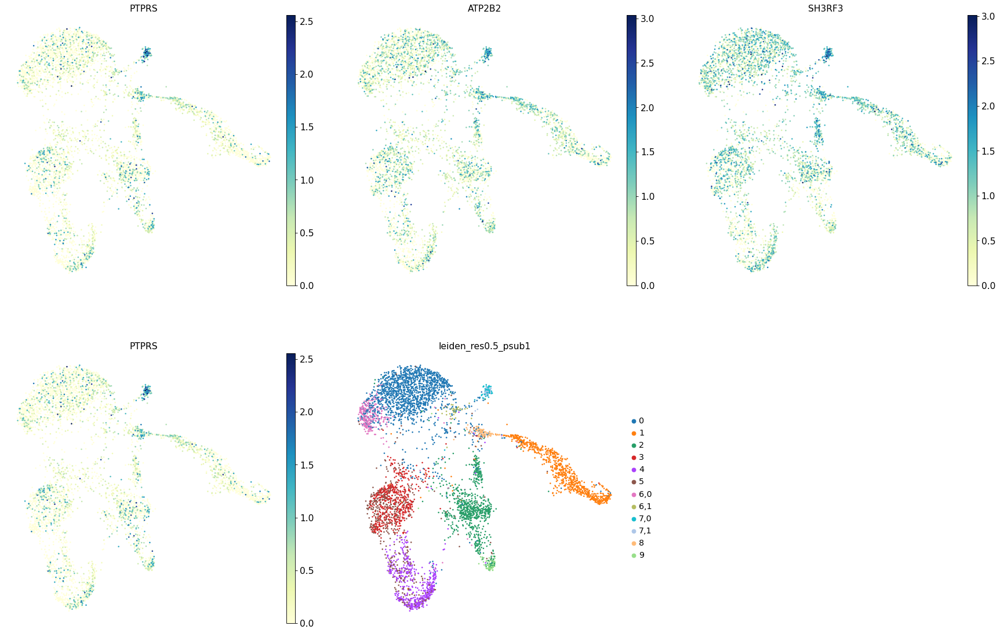

In [51]:
top_2_genes = list(adata_atac.uns[new_rg_key]['names'][0])+list(adata_atac.uns[new_rg_key]['names'][1])
sc.pl.umap(adata_atac, color=top_2_genes+[new_key], ncols=3)

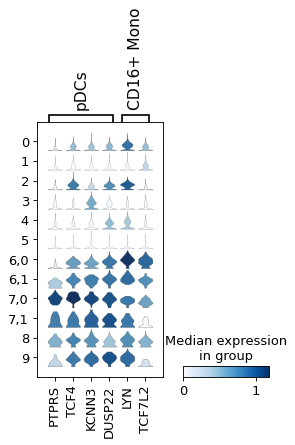

In [52]:
sc.pl.stacked_violin(adata_atac, var_names={a:marker_genes[a] for a in ['pDCs','CD16+ Mono']}, groupby=new_key)

## T cells

Clusters 3, 5 have CD4 + T cell population. We will assess the cluster 4 later in NK-ILC clusters.

In [53]:
marker_genes

{'CD14+ Mono': ['TREM1', 'FPR1'],
 'CD16+ Mono': ['LYN', 'TCF7L2'],
 'ID2-hi myeloid prog': ['KLF4'],
 'cDC2': ['TREM1', 'DMXL2'],
 'Normoblast': ['GATA1', 'HBA1', 'SLC4A1', 'SLC25A37', 'KLF1'],
 'Erythroblast': ['GATA1', 'MKI67'],
 'Proerythroblast': ['GATA2', 'SYNGR1'],
 'NK': ['CD160', 'GNLY', 'GRIK4', 'CD247'],
 'ILC': ['SPON2', 'GZMB', 'PRF1'],
 'Lymph prog': ['MME', 'IGLL1', 'VPREB1', 'CD79B'],
 'Naive CD20+ B': ['MS4A1', 'LYN', 'CD74', 'BLK'],
 'B1 B': ['ITGB1', 'MS4A1', 'DUSP22', 'EPHA4'],
 'Transitional B': ['MME', 'CD38', 'CD24'],
 'Plasma cells': ['DUSP22', 'FNDC3B'],
 'CD4+ T activated': ['JAKMIP1', 'C4orf50'],
 'CD4+ T naive': ['BCL11B', 'BACH2', 'JAKMIP1', 'C4orf50'],
 'CD8+ T': ['CD8A', 'CD8B'],
 'pDCs': ['PTPRS', 'TCF4', 'KCNN3', 'DUSP22'],
 'G/M prog': ['MPO', 'NT5DC3'],
 'HSC': ['PRDM16', 'MTRNR2L1'],
 'MK/E prog': ['DNAJC6']}

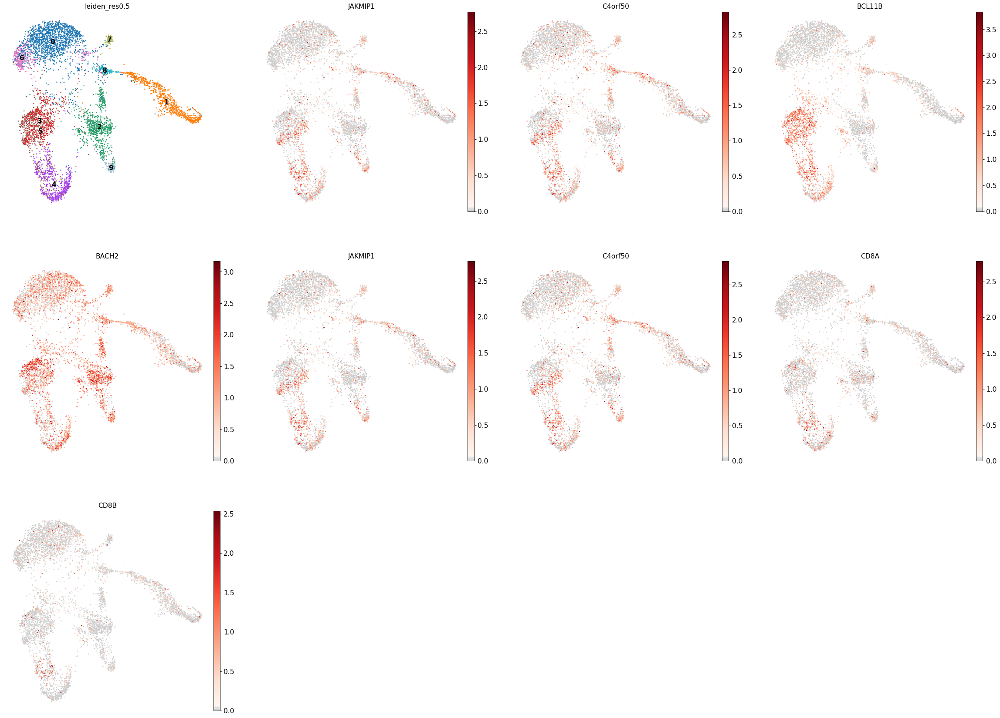

In [54]:
# Replot clusters and marker genes
sc.pl.umap(adata_atac, cmap=mymap, legend_loc = 'on data',
           color = [leiden_clus_col]+
              marker_genes['CD4+ T activated']+
              marker_genes['CD4+ T naive']+
              marker_genes['CD8+ T']
          )

### cluster 3

In [55]:
c_id = 3

In [56]:
# Initial assignment
init_clus_dict[str(c_id)]

['CD4+ T naive']

In [57]:
# Once the resolution looks good change new_key to leiden final
orig_key = leiden_clus_col
#new_key = 'leiden_temp'
new_key = 'leiden_tsub1'
new_rg_key = 'rg_tsub1'
sub_key = str(c_id)

In [58]:
res=0.4
sc.tl.leiden(adata_atac, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)

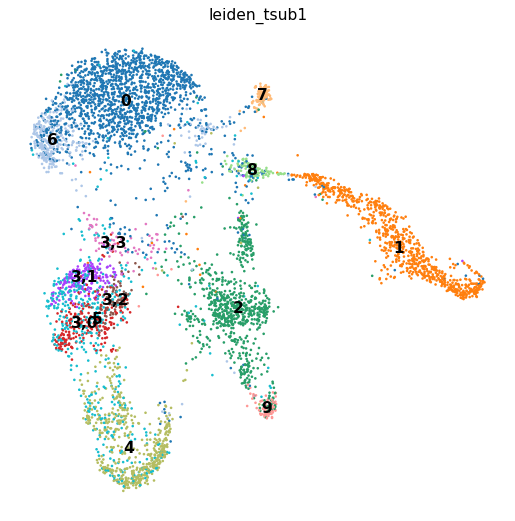

0      1628
1       809
2       784
4       532
5       510
6       332
3,0     214
3,1     181
7       120
8       104
3,2      84
9        84
3,3      72
Name: leiden_tsub1, dtype: int64

In [59]:
sc.pl.umap(adata_atac, color=new_key, legend_loc='on data')
adata_atac.obs[new_key].value_counts()

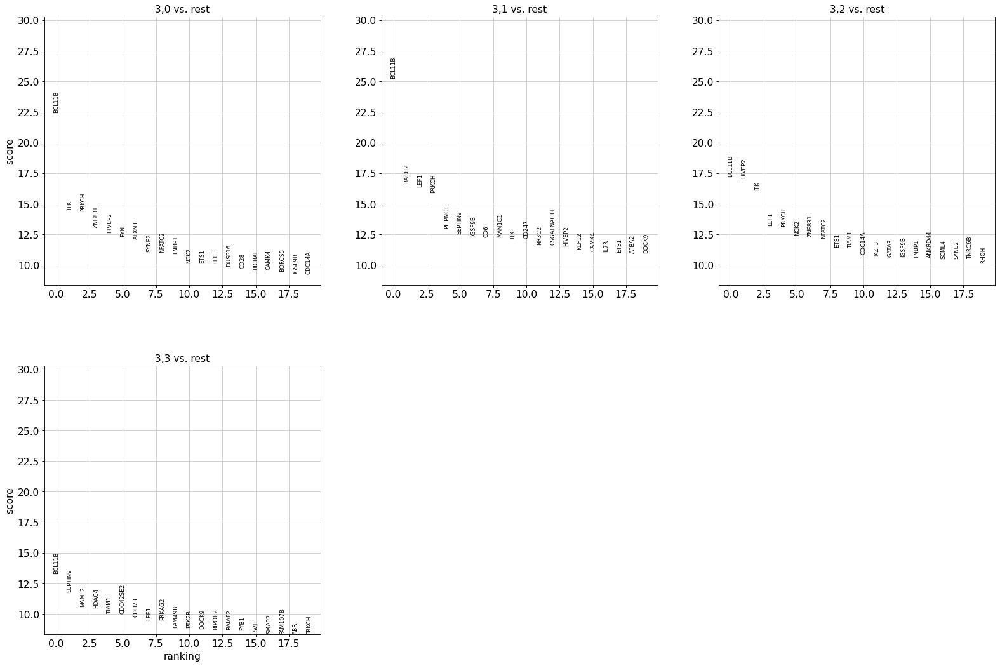

In [60]:
# Check markers of subclusters

#set number of clusters
num_subclusts = 4

new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_atac, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_atac, key=new_rg_key, groups=new_groups, ncols=3)

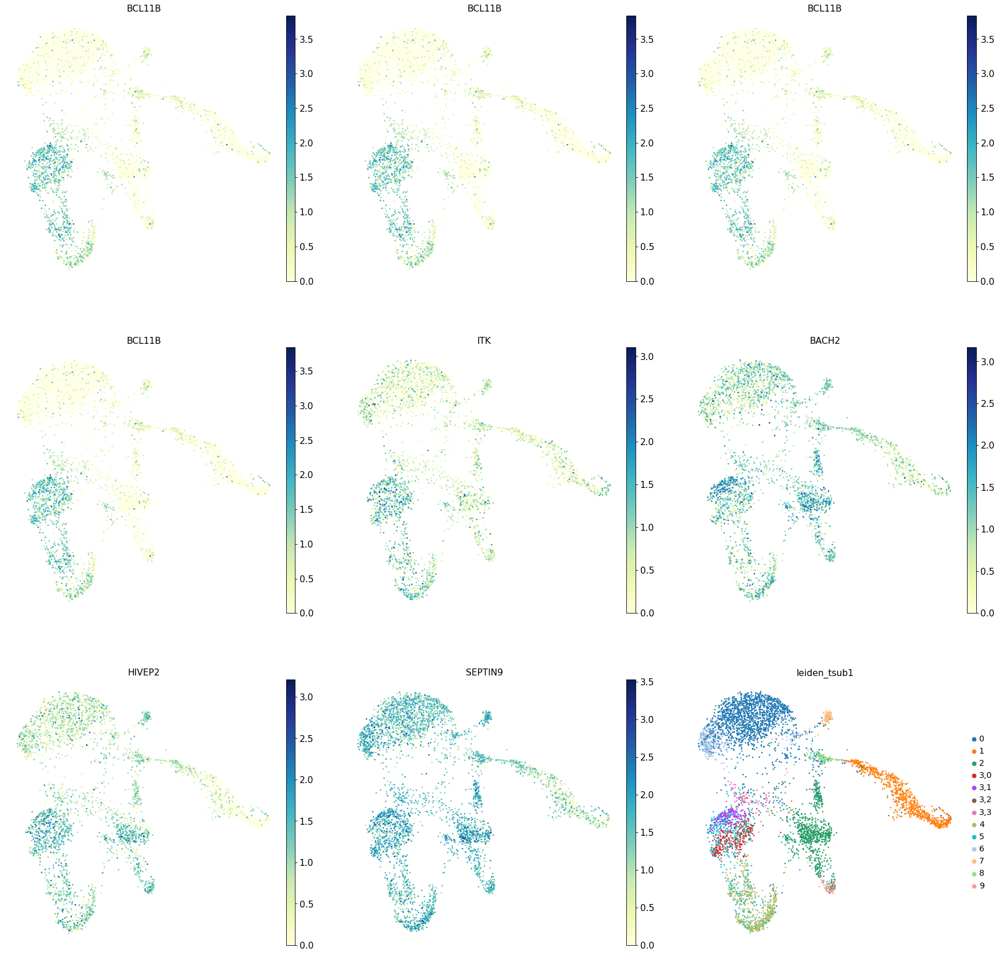

In [61]:
top_2_genes = list(adata_atac.uns[new_rg_key]['names'][0])+list(adata_atac.uns[new_rg_key]['names'][1])
sc.pl.umap(adata_atac, color=top_2_genes+[new_key], ncols=3)

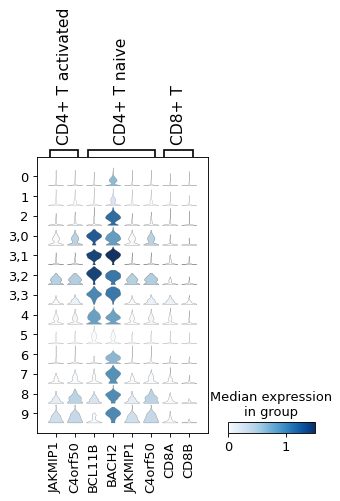

In [62]:
sc.pl.stacked_violin(adata_atac, var_names={a:marker_genes[a] for a in ['CD4+ T activated', 'CD4+ T naive', 'CD8+ T']}, groupby=new_key)

#### Conclusion

- 3,0: CD4+ T activated
- 3,1: CD4+ T naive
- 3,2: CD4+ T activated
- 3,3: CD4+ T naive

This is because there are some expresions for negative marker genes, such as JAKMIP1 and C4orf50.



### cluster 5

From the UMAP above, the cluster 4 does not seem to have a clear sub-structure.
Still, let's see if there's a sub-structure that we could sub-cluster further.

In [63]:
c_id = 5

In [64]:
# Initial assignment
init_clus_dict[str(c_id)]

['CD4+ T naive', 'CD4+ T activated']

In [65]:
# Once the resolution looks good change new_key to leiden final
orig_key = 'leiden_tsub1'
#new_key = 'leiden_temp'
new_key = 'leiden_tsub2'
new_rg_key = 'rg_tsub2'
sub_key = str(c_id)

In [66]:
res=0.3
sc.tl.leiden(adata_atac, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)

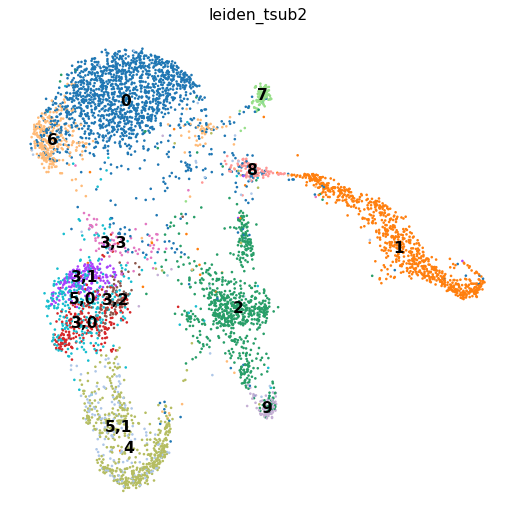

0      1628
1       809
2       784
4       532
6       332
5,0     328
3,0     214
5,1     182
3,1     181
7       120
8       104
3,2      84
9        84
3,3      72
Name: leiden_tsub2, dtype: int64

In [67]:
sc.pl.umap(adata_atac, color=new_key, legend_loc='on data')
adata_atac.obs[new_key].value_counts()

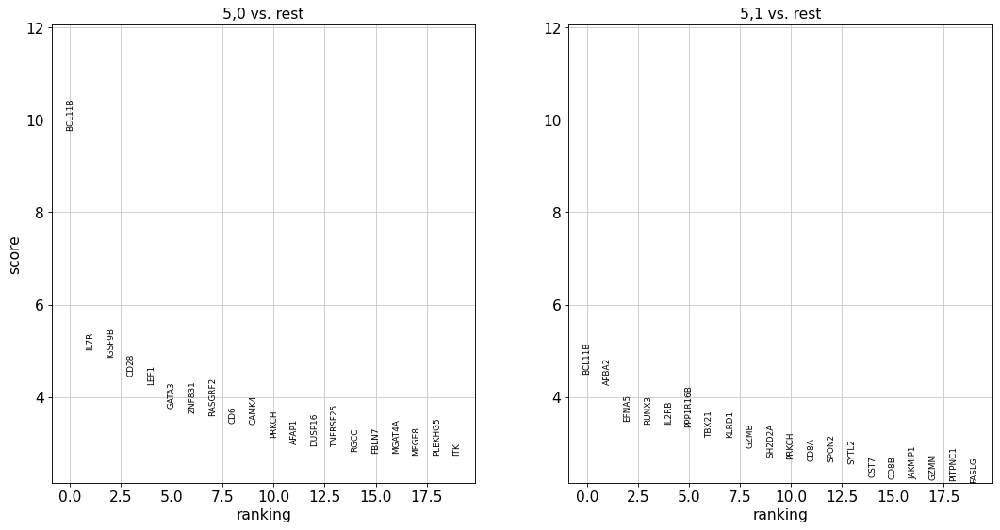

In [68]:
# Check markers of subclusters

#set number of clusters
num_subclusts = 2

new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_atac, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_atac, key=new_rg_key, groups=new_groups, ncols=3)

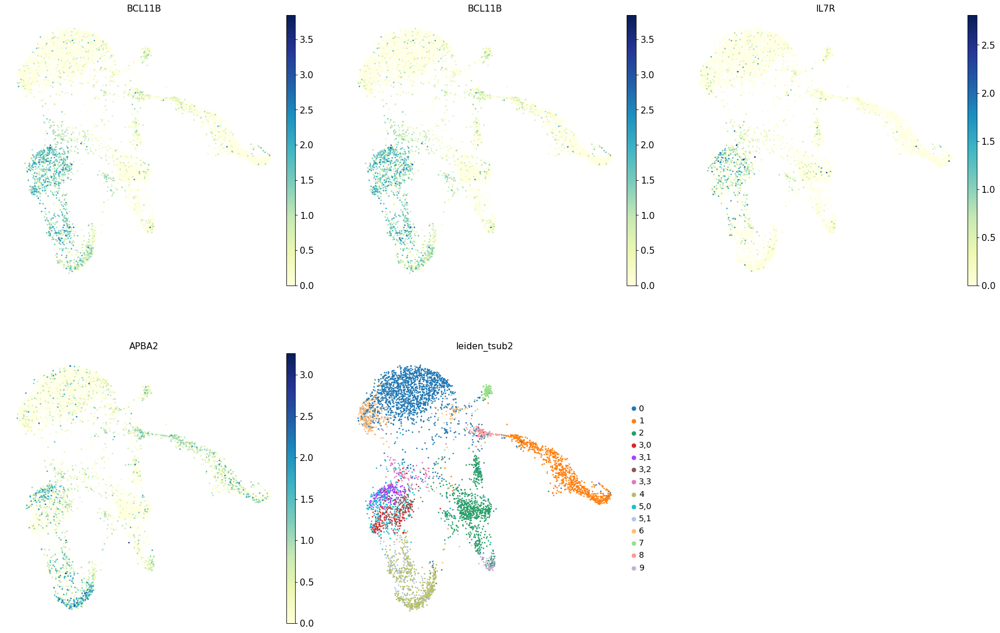

In [69]:
top_2_genes = list(adata_atac.uns[new_rg_key]['names'][0])+list(adata_atac.uns[new_rg_key]['names'][1])
sc.pl.umap(adata_atac, color=top_2_genes+[new_key], ncols=3)

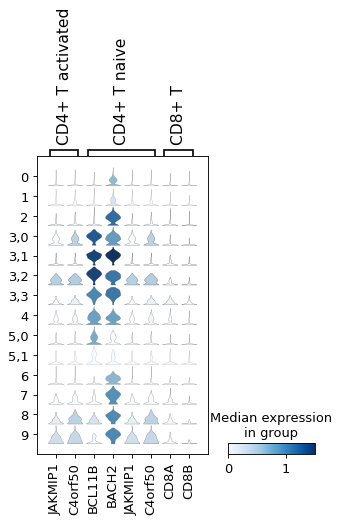

In [70]:
sc.pl.stacked_violin(adata_atac, var_names={a:marker_genes[a] for a in ['CD4+ T activated', 'CD4+ T naive', 'CD8+ T']}, groupby=new_key)

#### Conclusion
- 5,0: CD4+ T naive
- 5,1: low quality T cells

## NK - ILC

In [71]:
marker_genes

{'CD14+ Mono': ['TREM1', 'FPR1'],
 'CD16+ Mono': ['LYN', 'TCF7L2'],
 'ID2-hi myeloid prog': ['KLF4'],
 'cDC2': ['TREM1', 'DMXL2'],
 'Normoblast': ['GATA1', 'HBA1', 'SLC4A1', 'SLC25A37', 'KLF1'],
 'Erythroblast': ['GATA1', 'MKI67'],
 'Proerythroblast': ['GATA2', 'SYNGR1'],
 'NK': ['CD160', 'GNLY', 'GRIK4', 'CD247'],
 'ILC': ['SPON2', 'GZMB', 'PRF1'],
 'Lymph prog': ['MME', 'IGLL1', 'VPREB1', 'CD79B'],
 'Naive CD20+ B': ['MS4A1', 'LYN', 'CD74', 'BLK'],
 'B1 B': ['ITGB1', 'MS4A1', 'DUSP22', 'EPHA4'],
 'Transitional B': ['MME', 'CD38', 'CD24'],
 'Plasma cells': ['DUSP22', 'FNDC3B'],
 'CD4+ T activated': ['JAKMIP1', 'C4orf50'],
 'CD4+ T naive': ['BCL11B', 'BACH2', 'JAKMIP1', 'C4orf50'],
 'CD8+ T': ['CD8A', 'CD8B'],
 'pDCs': ['PTPRS', 'TCF4', 'KCNN3', 'DUSP22'],
 'G/M prog': ['MPO', 'NT5DC3'],
 'HSC': ['PRDM16', 'MTRNR2L1'],
 'MK/E prog': ['DNAJC6']}

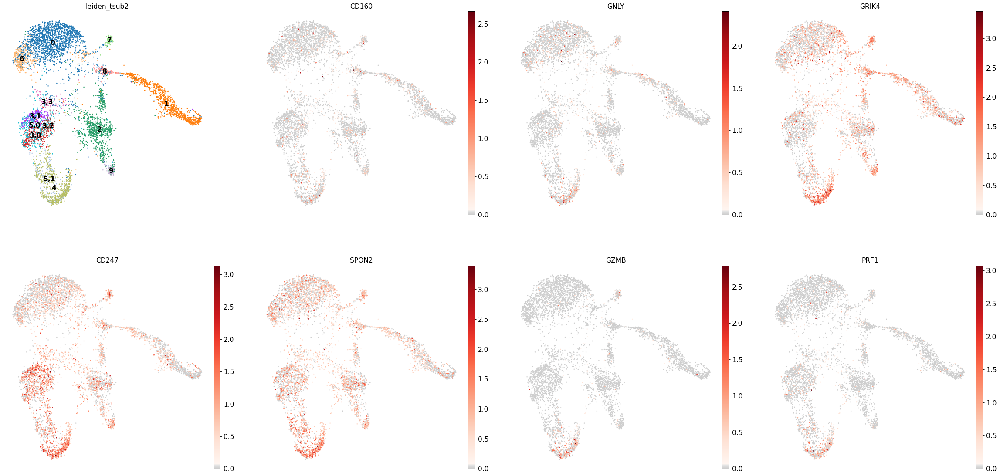

In [72]:
# Replot clusters and marker genes
sc.pl.umap(adata_atac, cmap=mymap, legend_loc = 'on data',
           color = ['leiden_tsub2']+
              marker_genes['NK']+
              marker_genes['ILC']
          )

### cluster 4

In [73]:
c_id = 4

In [74]:
# Initial assignment
init_clus_dict[str(c_id)]

['NK', 'ILC', 'CD8+ T']

#### sub-clustering

In [75]:
# Once the resolution looks good change new_key to leiden final
orig_key = 'leiden_tsub2'
#new_key = 'leiden_temp'
new_key = 'leiden_nsub'
new_rg_key = 'rg_nsub'
sub_key = str(c_id)

In [76]:
res=0.4
sc.tl.leiden(adata_atac, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)

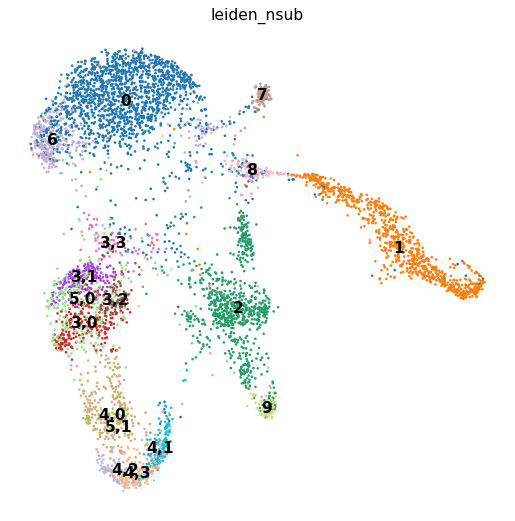

0      1628
1       809
2       784
6       332
5,0     328
3,0     214
4,0     187
5,1     182
3,1     181
4,1     133
7       120
4,2     113
8       104
4,3      99
3,2      84
9        84
3,3      72
Name: leiden_nsub, dtype: int64

In [77]:
sc.pl.umap(adata_atac, color=new_key, legend_loc='on data')
adata_atac.obs[new_key].value_counts()

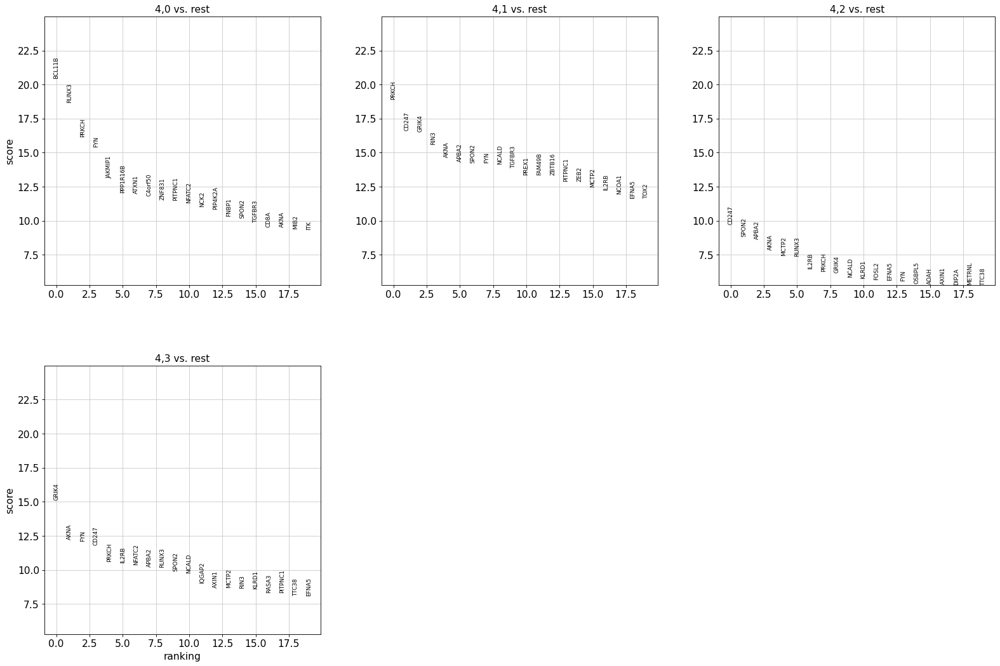

In [78]:
# Check markers of subclusters

#set number of clusters
num_subclusts = 4

new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_atac, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_atac, key=new_rg_key, groups=new_groups, ncols=3)

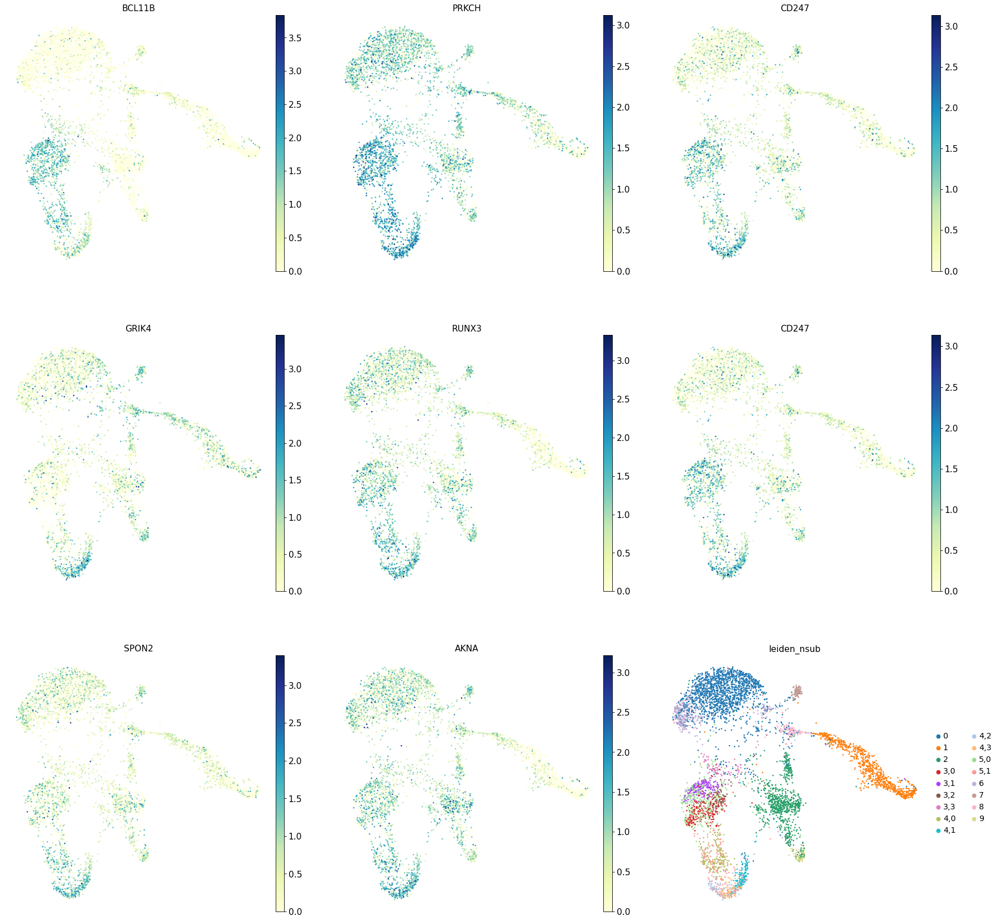

In [79]:
top_2_genes = list(adata_atac.uns[new_rg_key]['names'][0])+list(adata_atac.uns[new_rg_key]['names'][1])
sc.pl.umap(adata_atac, color=top_2_genes+[new_key], ncols=3)

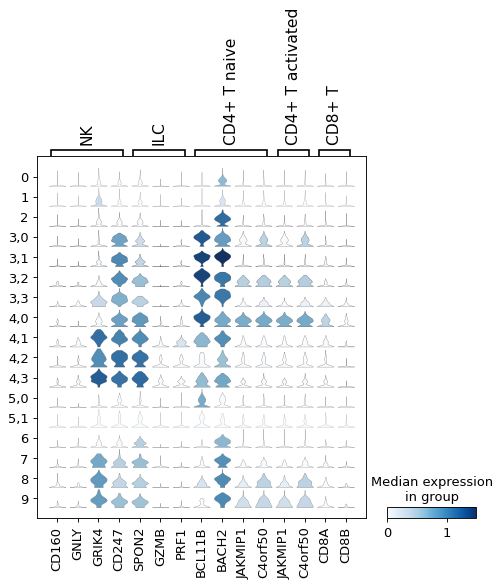

In [80]:
sc.pl.stacked_violin(adata_atac, var_names={a:marker_genes[a] for a in ['NK','ILC','CD4+ T naive','CD4+ T activated','CD8+ T']}, groupby=new_key)

#### Conclusion
- 4,0: CD4+ T activated (JAKMIP1 and C4orf50 negative markers)
- 4,1: NK
- 4,2: NK
- 4,3: NK

## Proerythroblast - Erythroblast - Reticulocyte (cluster 1)

In [81]:
marker_genes

{'CD14+ Mono': ['TREM1', 'FPR1'],
 'CD16+ Mono': ['LYN', 'TCF7L2'],
 'ID2-hi myeloid prog': ['KLF4'],
 'cDC2': ['TREM1', 'DMXL2'],
 'Normoblast': ['GATA1', 'HBA1', 'SLC4A1', 'SLC25A37', 'KLF1'],
 'Erythroblast': ['GATA1', 'MKI67'],
 'Proerythroblast': ['GATA2', 'SYNGR1'],
 'NK': ['CD160', 'GNLY', 'GRIK4', 'CD247'],
 'ILC': ['SPON2', 'GZMB', 'PRF1'],
 'Lymph prog': ['MME', 'IGLL1', 'VPREB1', 'CD79B'],
 'Naive CD20+ B': ['MS4A1', 'LYN', 'CD74', 'BLK'],
 'B1 B': ['ITGB1', 'MS4A1', 'DUSP22', 'EPHA4'],
 'Transitional B': ['MME', 'CD38', 'CD24'],
 'Plasma cells': ['DUSP22', 'FNDC3B'],
 'CD4+ T activated': ['JAKMIP1', 'C4orf50'],
 'CD4+ T naive': ['BCL11B', 'BACH2', 'JAKMIP1', 'C4orf50'],
 'CD8+ T': ['CD8A', 'CD8B'],
 'pDCs': ['PTPRS', 'TCF4', 'KCNN3', 'DUSP22'],
 'G/M prog': ['MPO', 'NT5DC3'],
 'HSC': ['PRDM16', 'MTRNR2L1'],
 'MK/E prog': ['DNAJC6']}

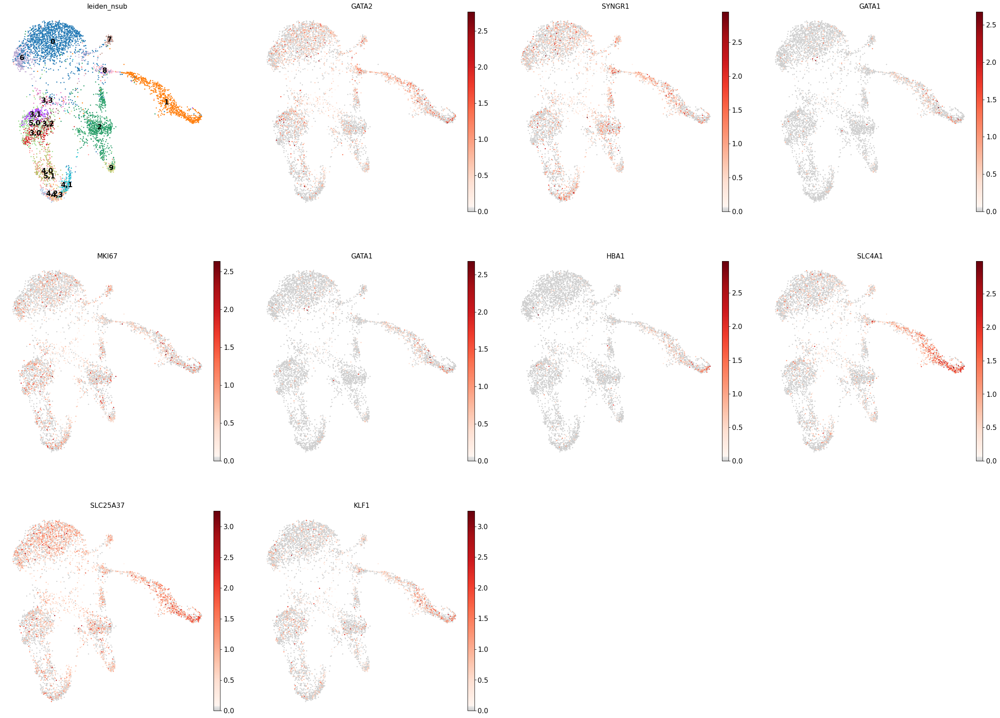

In [82]:
# Replot clusters and marker genes
sc.pl.umap(adata_atac, cmap=mymap, legend_loc = 'on data',
           color = ['leiden_nsub']+
           marker_genes['Proerythroblast']+
           marker_genes['Erythroblast']+
           marker_genes['Normoblast']
          )

### cluster 1

In [83]:
c_id = 1

In [84]:
# Initial assignment
init_clus_dict[str(c_id)]

['Normoblast', 'Proerythroblast', 'Erythroblast']

In [85]:
# Once the resolution looks good change new_key to leiden final
orig_key = 'leiden_nsub'
#new_key = 'leiden_temp'
new_key = 'leiden_esub'
new_rg_key = 'rg_esub'
sub_key = str(c_id)

In [86]:
res=0.3
sc.tl.leiden(adata_atac, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)

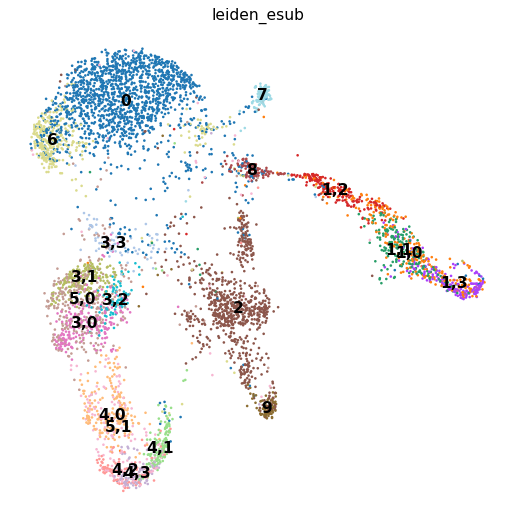

0      1628
2       784
6       332
5,0     328
1,0     246
3,0     214
1,1     200
1,2     190
4,0     187
5,1     182
3,1     181
1,3     173
4,1     133
7       120
4,2     113
8       104
4,3      99
3,2      84
9        84
3,3      72
Name: leiden_esub, dtype: int64

In [87]:
sc.pl.umap(adata_atac, color=new_key, legend_loc='on data')
adata_atac.obs[new_key].value_counts()

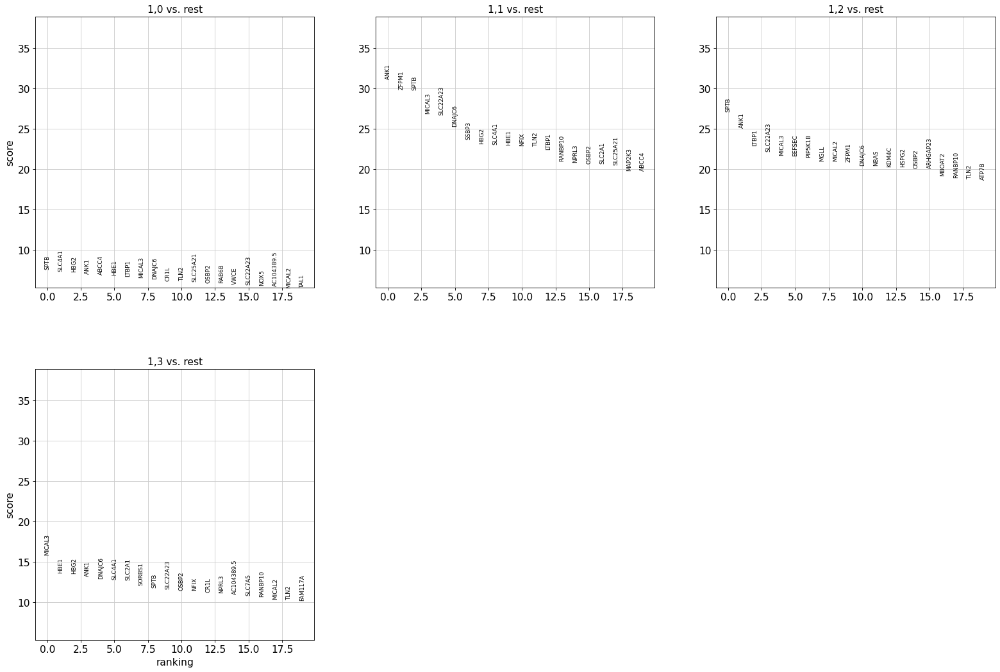

In [88]:
# Check markers of subclusters

#set number of clusters
num_subclusts = 4

new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_atac, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_atac, key=new_rg_key, groups=new_groups, ncols=3)

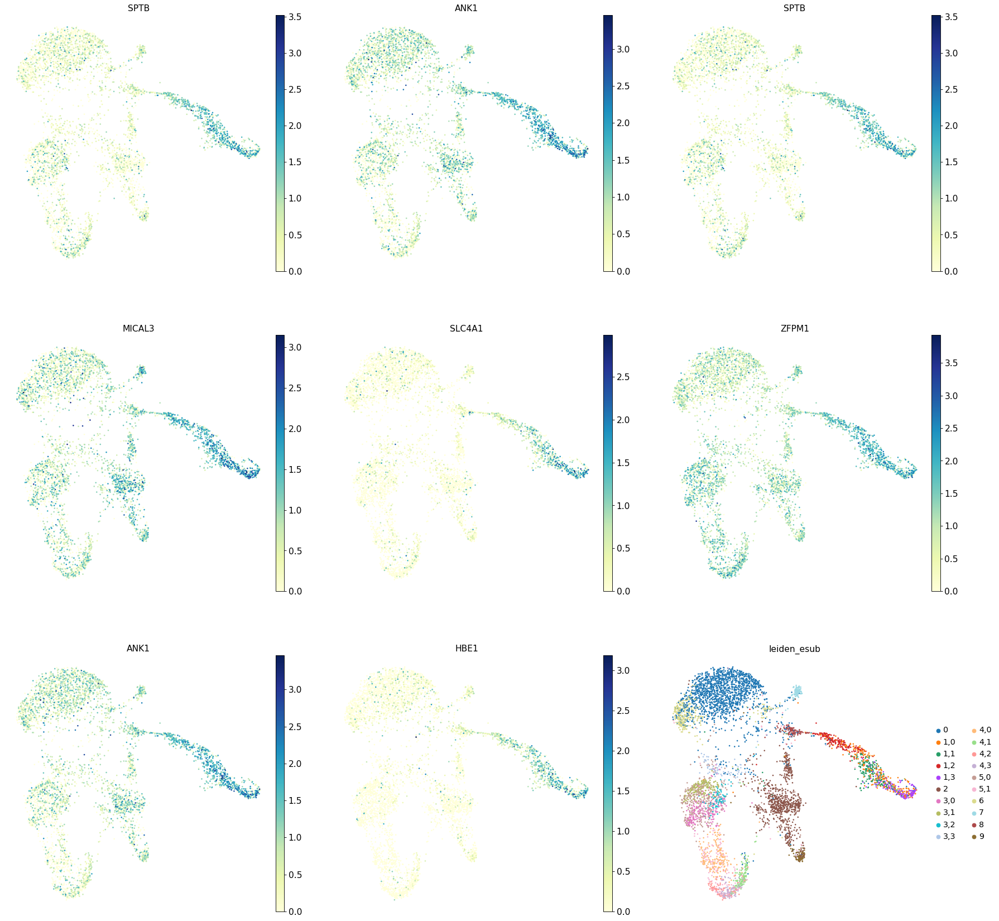

In [89]:
top_2_genes = list(adata_atac.uns[new_rg_key]['names'][0])+list(adata_atac.uns[new_rg_key]['names'][1])
sc.pl.umap(adata_atac, color=top_2_genes+[new_key], ncols=3)

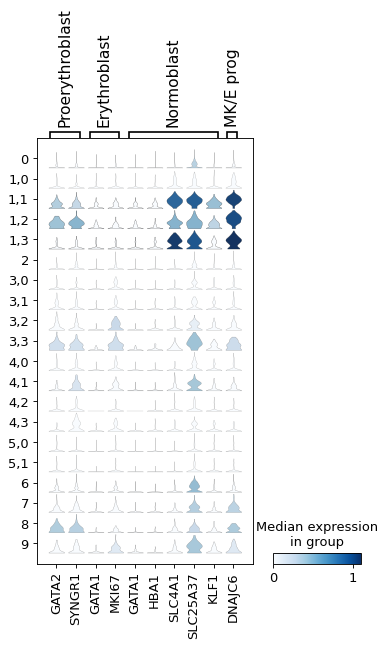

In [90]:
sc.pl.stacked_violin(adata_atac, var_names={a:marker_genes[a] for a in ['Proerythroblast','Erythroblast','Normoblast','MK/E prog']}, groupby=new_key)

#### Conclusion

- 1,0: Erythroblast
- 1,1: Erythroblast
- 1,2: Proerythroblast
- 1,3: Normoblast

## B cells - cluster 2

In [91]:
marker_genes

{'CD14+ Mono': ['TREM1', 'FPR1'],
 'CD16+ Mono': ['LYN', 'TCF7L2'],
 'ID2-hi myeloid prog': ['KLF4'],
 'cDC2': ['TREM1', 'DMXL2'],
 'Normoblast': ['GATA1', 'HBA1', 'SLC4A1', 'SLC25A37', 'KLF1'],
 'Erythroblast': ['GATA1', 'MKI67'],
 'Proerythroblast': ['GATA2', 'SYNGR1'],
 'NK': ['CD160', 'GNLY', 'GRIK4', 'CD247'],
 'ILC': ['SPON2', 'GZMB', 'PRF1'],
 'Lymph prog': ['MME', 'IGLL1', 'VPREB1', 'CD79B'],
 'Naive CD20+ B': ['MS4A1', 'LYN', 'CD74', 'BLK'],
 'B1 B': ['ITGB1', 'MS4A1', 'DUSP22', 'EPHA4'],
 'Transitional B': ['MME', 'CD38', 'CD24'],
 'Plasma cells': ['DUSP22', 'FNDC3B'],
 'CD4+ T activated': ['JAKMIP1', 'C4orf50'],
 'CD4+ T naive': ['BCL11B', 'BACH2', 'JAKMIP1', 'C4orf50'],
 'CD8+ T': ['CD8A', 'CD8B'],
 'pDCs': ['PTPRS', 'TCF4', 'KCNN3', 'DUSP22'],
 'G/M prog': ['MPO', 'NT5DC3'],
 'HSC': ['PRDM16', 'MTRNR2L1'],
 'MK/E prog': ['DNAJC6']}

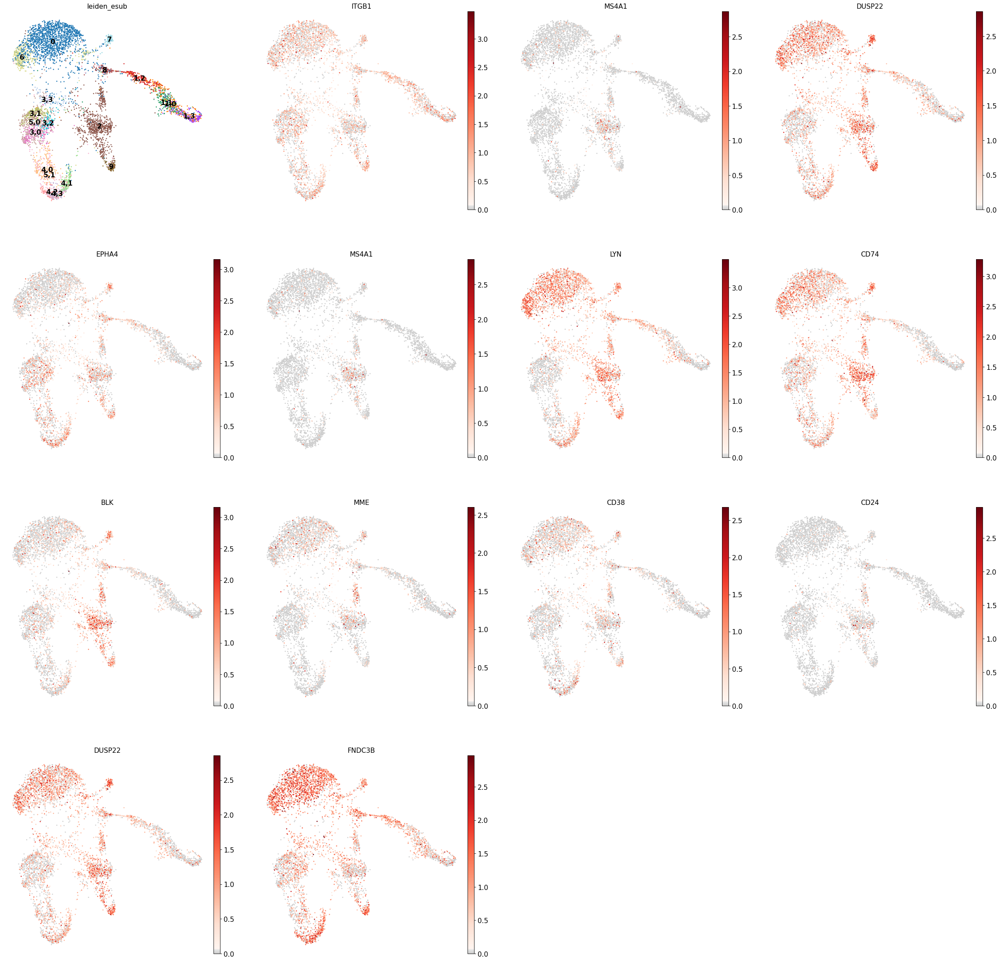

In [92]:
# Replot clusters and marker genes
sc.pl.umap(adata_atac, cmap=mymap, legend_loc = 'on data',
           color = ['leiden_esub']+
           marker_genes['B1 B']+
           marker_genes['Naive CD20+ B']+
           marker_genes['Transitional B']+
           marker_genes['Plasma cells']
          )

### cluster 2

In [93]:
c_id = 2

In [94]:
# Initial assignment
init_clus_dict[str(c_id)]

['Naive CD20+ B', 'B1 B', 'Transitional B']

#### Split substructure

In [95]:
# Once the resolution looks good change new_key to leiden final
orig_key = 'leiden_esub'
#new_key = 'leiden_temp'
new_key = 'leiden_bsub1'
new_rg_key = 'rg_bsub1'
sub_key = str(c_id)

In [96]:
res=0.2
sc.tl.leiden(adata_atac, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)

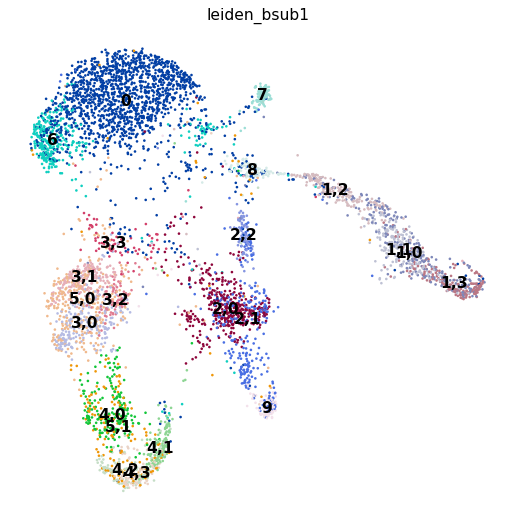

0      1628
2,0     406
6       332
5,0     328
2,1     304
1,0     246
3,0     214
1,1     200
1,2     190
4,0     187
5,1     182
3,1     181
1,3     173
4,1     133
7       120
4,2     113
8       104
4,3      99
9        84
3,2      84
2,2      74
3,3      72
Name: leiden_bsub1, dtype: int64

In [97]:
sc.pl.umap(adata_atac, color=new_key, legend_loc='on data')
adata_atac.obs[new_key].value_counts()

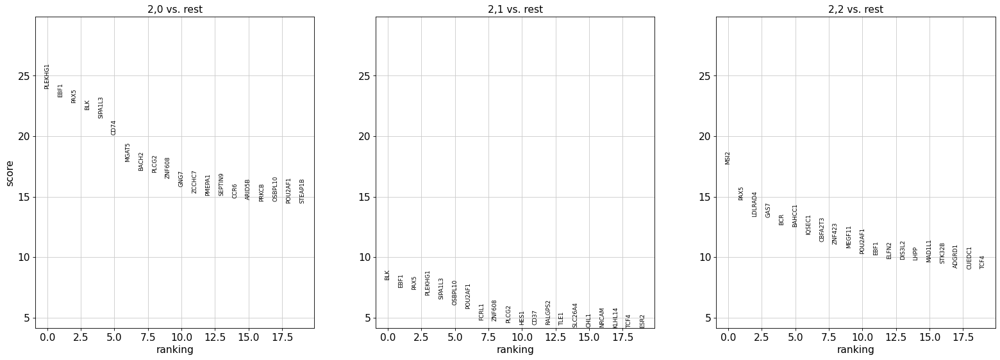

In [98]:
# Check markers of subclusters

#set number of clusters
num_subclusts = 3

new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_atac, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_atac, key=new_rg_key, groups=new_groups, ncols=3)

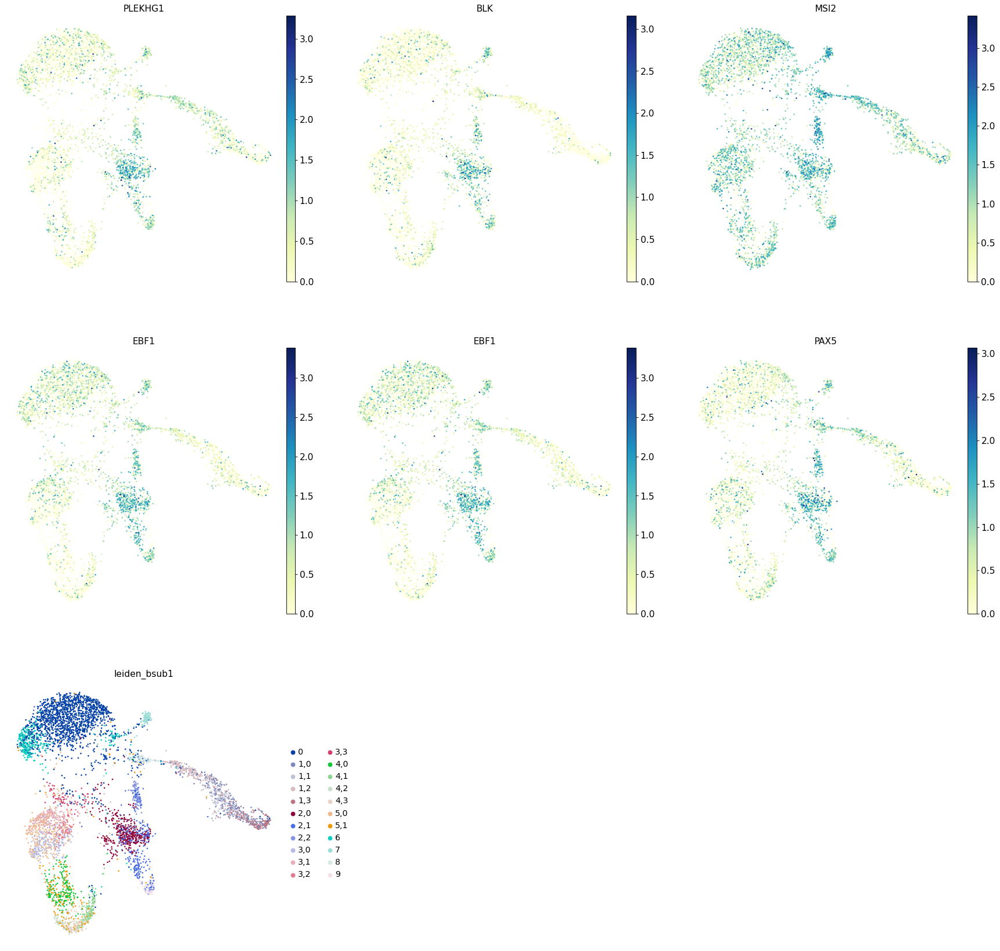

In [99]:
top_2_genes = list(adata_atac.uns[new_rg_key]['names'][0])+list(adata_atac.uns[new_rg_key]['names'][1])
sc.pl.umap(adata_atac, color=top_2_genes+[new_key], ncols=3)

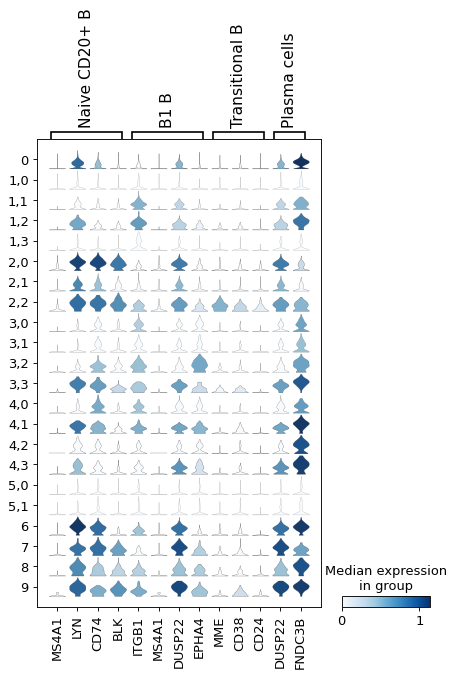

In [100]:
sc.pl.stacked_violin(adata_atac, var_names={a:marker_genes[a] for a in ['Naive CD20+ B','B1 B','Transitional B','Plasma cells']}, groupby=new_key)

#### Conclusion

- 2,0: Naive CD20+ B
- 2,1: Naive CD20+ B
- 2,2: Transitional B

## cluster 8

In [101]:
c_id = 8

In [102]:
# Initial assignment
init_clus_dict[str(c_id)]

['HSC']

#### Split substructure

In [103]:
# Once the resolution looks good change new_key to leiden final
orig_key = 'leiden_bsub1'
#new_key = 'leiden_temp'
new_key = 'leiden_bsub2'
new_rg_key = 'rg_bsub2'
sub_key = str(c_id)

In [104]:
res=0.5
sc.tl.leiden(adata_atac, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)

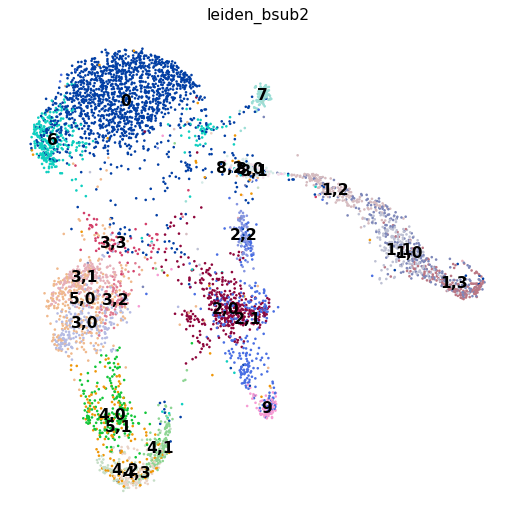

0      1628
2,0     406
6       332
5,0     328
2,1     304
1,0     246
3,0     214
1,1     200
1,2     190
4,0     187
5,1     182
3,1     181
1,3     173
4,1     133
7       120
4,2     113
4,3      99
3,2      84
9        84
2,2      74
3,3      72
8,0      60
8,1      39
8,2       5
Name: leiden_bsub2, dtype: int64

In [105]:
sc.pl.umap(adata_atac, color=new_key, legend_loc='on data')
adata_atac.obs[new_key].value_counts()

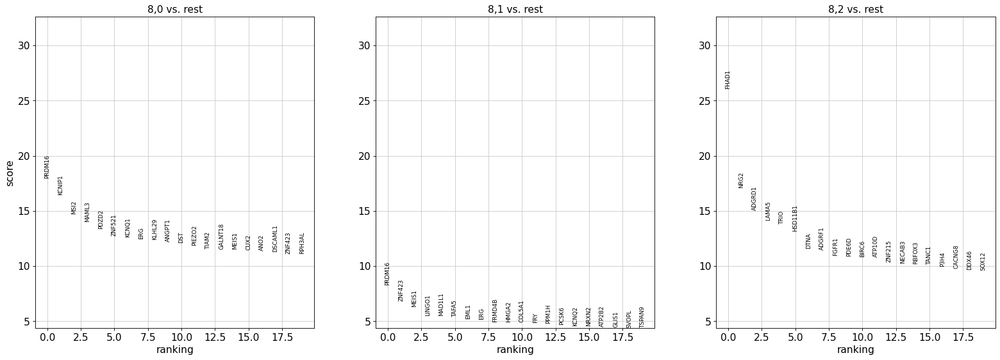

In [106]:
# Check markers of subclusters

#set number of clusters
num_subclusts = 3

new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_atac, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_atac, key=new_rg_key, groups=new_groups, ncols=3)

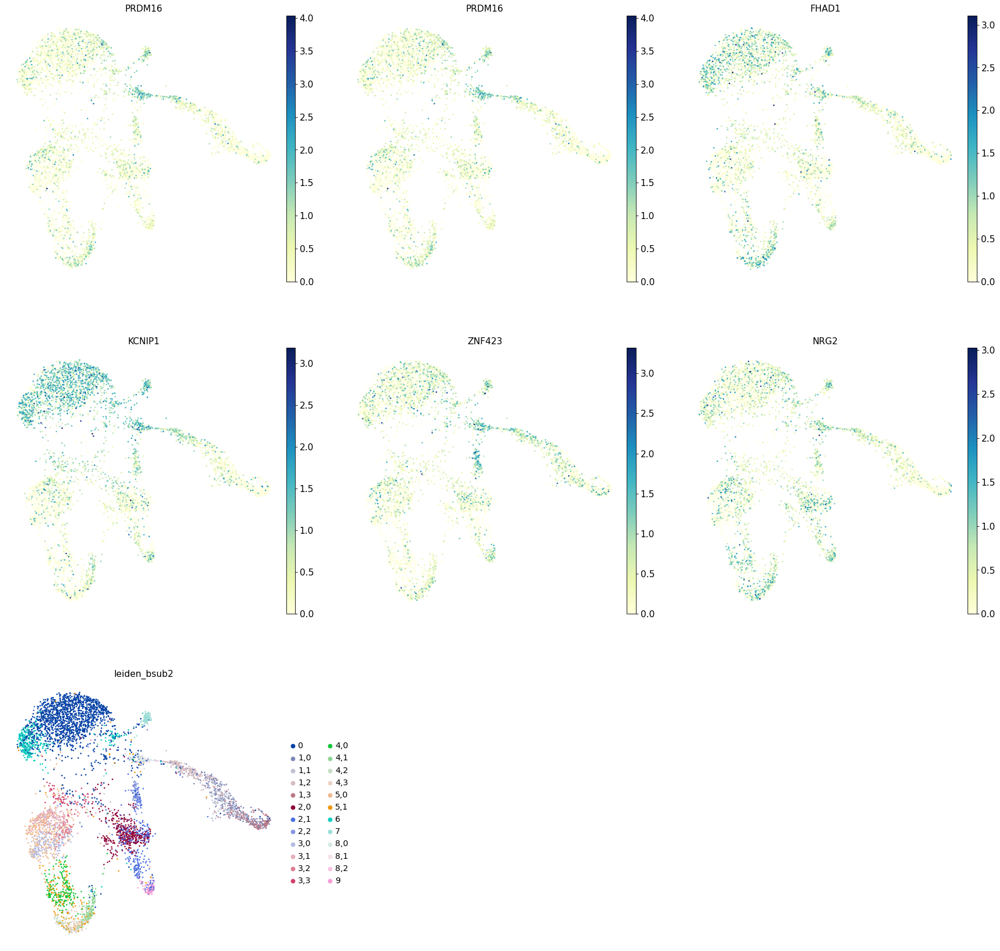

In [107]:
top_2_genes = list(adata_atac.uns[new_rg_key]['names'][0])+list(adata_atac.uns[new_rg_key]['names'][1])
sc.pl.umap(adata_atac, color=top_2_genes+[new_key], ncols=3)

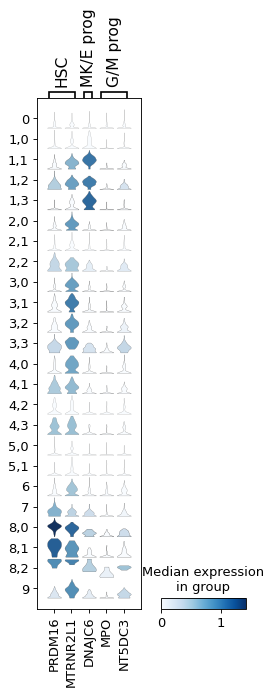

In [108]:
sc.pl.stacked_violin(adata_atac, var_names={a:marker_genes[a] for a in ['HSC', 'MK/E prog', 'G/M prog']}, groupby=new_key)

#### Conclusion

- 8,0: HSC
- 8,1: G/M prog
- 8,2: MK/E prog

**YJK to ML**: This sub-clustering might not be accurate...

## Final annotation

In [109]:
init_clus_dict

{'0': ['CD 14+ Mono', 'CD 16+ Mono', 'ID2-hi myeloid prog', 'cDC2'],
 '1': ['Normoblast', 'Proerythroblast', 'Erythroblast'],
 '2': ['Naive CD20+ B', 'B1 B', 'Transitional B'],
 '3': ['CD4+ T naive'],
 '4': ['NK', 'ILC', 'CD8+ T'],
 '5': ['CD4+ T naive', 'CD4+ T activated'],
 '6': ['CD16+ Mono', 'cDC2', 'CD 14+ Mono', 'CD 16+ Mono', 'G/M prog'],
 '7': ['pDCs'],
 '8': ['HSC'],
 '9': ['pDCs', 'Plasma cells', 'Transitional B']}

In [122]:
final_clus_dict = {

    '0':'CD14+ Mono',

    '1,0':'Erythroblast',
    '1,1':'Erythroblast',
    '1,2':'Proerythroblast',
    '1,3':'Normoblast',
    
    '2,0':'Naive CD20+ B',
    '2,1':'Naive CD20+ B',
    '2,2':'Transitional B',
    
    '3,0':'CD4+ T activated', 
    '3,1':'CD4+ T naive', 
    '3,2':'CD4+ T activated', 
    '3,3':'CD4+ T naive', 

    '4,0':'CD4+ T activated',
    '4,1':'NK',
    '4,2':'NK',
    '4,3':'NK',

    '5,0':'CD4+ T naive',
    '5,1':'low quality T cells',
    
    '6,0':'CD16+ Mono', 
    
    '7':'pDCs',
    
    '8,0':'HSC',
    '8,1':'G/M prog',
    '8,2':'MK/E prog',
    
    '9':'Plasma cells'
    
}

## Marker overview

#### Doublet filtering

We will not filter out any cells here, as it's likely that the doublets were already filtered out by the GEX notebook.


In [112]:
adata_atac.obs['leiden_bsub1'].value_counts()

0      1628
2,0     406
6       332
5,0     328
2,1     304
1,0     246
3,0     214
1,1     200
1,2     190
4,0     187
5,1     182
3,1     181
1,3     173
4,1     133
7       120
4,2     113
8       104
4,3      99
9        84
3,2      84
2,2      74
3,3      72
Name: leiden_bsub1, dtype: int64

In [113]:
# Make a copy of the adata for merging sub-clusters
adata_atac_filt = adata_atac.copy()

In [131]:
# Merge the sub-clusters with the same identities
# erythroblast
adata_atac_filt.obs['leiden_intermediate1'] = ['1,0' if c in ['1,0','1,1'] else c for c in adata_atac_filt.obs['leiden_bsub2']]
# Naive CD20+ B
adata_atac_filt.obs['leiden_intermediate2'] = ['2,0' if c in ['2,0','2,1'] else c for c in adata_atac_filt.obs['leiden_intermediate1']]
# CD4+ T activated
adata_atac_filt.obs['leiden_intermediate3'] = ['3,0' if c in ['3,0','3,2','4,0'] else c for c in adata_atac_filt.obs['leiden_intermediate2']]
# Nk
adata_atac_filt.obs['leiden_intermediate4'] = ['4,1' if c in ['4,1','4,2','4,3'] else c for c in adata_atac_filt.obs['leiden_intermediate3']]
# CD4+ T naive
adata_atac_filt.obs['leiden_final'] = ['3,1' if c in ['3,1','3,3','5,0'] else c for c in adata_atac_filt.obs['leiden_intermediate4']]


adata_atac_filt.obs['leiden_final'] = adata_atac_filt.obs['leiden_final'].astype('category')
adata_atac_filt.obs['leiden_final'].cat.categories
adata_atac_filt.obs['leiden_final'].value_counts()

0      1628
2,0     710
3,1     581
3,0     485
1,0     446
4,1     345
6       332
1,2     190
5,1     182
1,3     173
7       120
9        84
2,2      74
8,0      60
8,1      39
8,2       5
Name: leiden_final, dtype: int64

In [132]:
adata_atac_filt.obs['leiden_final'].cat.categories

Index(['0', '1,0', '1,2', '1,3', '2,0', '2,2', '3,0', '3,1', '4,1', '5,1', '6',
       '7', '8,0', '8,1', '8,2', '9'],
      dtype='object')

In [133]:
rename_clust_dict = {
    
    '0':'CD14+ Mono',

    '1,0':'Erythroblast',
    '1,2':'Proerythroblast',
    '1,3':'Normoblast',
    
    '2,0':'Naive CD20+ B',
    '2,2':'Transitional B',
    
    '3,0':'CD4+ T activated', 
    '3,1':'CD4+ T naive', 

    '4,1':'NK',

    '5,1':'low quality T cells',
    
    '6':'CD16+ Mono', 
    
    '7':'pDCs',
    
    '8,0':'HSC',
    '8,1':'G/M prog',
    '8,2':'MK/E prog',
    
    '9':'Plasma cells'
    

}


In [134]:
# Note: this must be done in the same order as the categories above!
adata_atac_filt.rename_categories('leiden_final', [rename_clust_dict[ct] for ct in adata_atac_filt.obs['leiden_final'].cat.categories])

In [135]:
adata_atac_filt.obs['leiden_final'].cat.categories

Index(['CD14+ Mono', 'Erythroblast', 'Proerythroblast', 'Normoblast',
       'Naive CD20+ B', 'Transitional B', 'CD4+ T activated', 'CD4+ T naive',
       'NK', 'low quality T cells', 'CD16+ Mono', 'pDCs', 'HSC', 'G/M prog',
       'MK/E prog', 'Plasma cells'],
      dtype='object')

In [ ]:
# Rename clusters

#adata_atac.obs['leiden_final'] = adata_atac.obs.leiden_sub.map(rename_clust_dict)

In [ ]:
#adata_atac.obs['leiden_final']

... storing 'leiden_intermediate1' as categorical
... storing 'leiden_intermediate2' as categorical
... storing 'leiden_intermediate3' as categorical
... storing 'leiden_intermediate4' as categorical


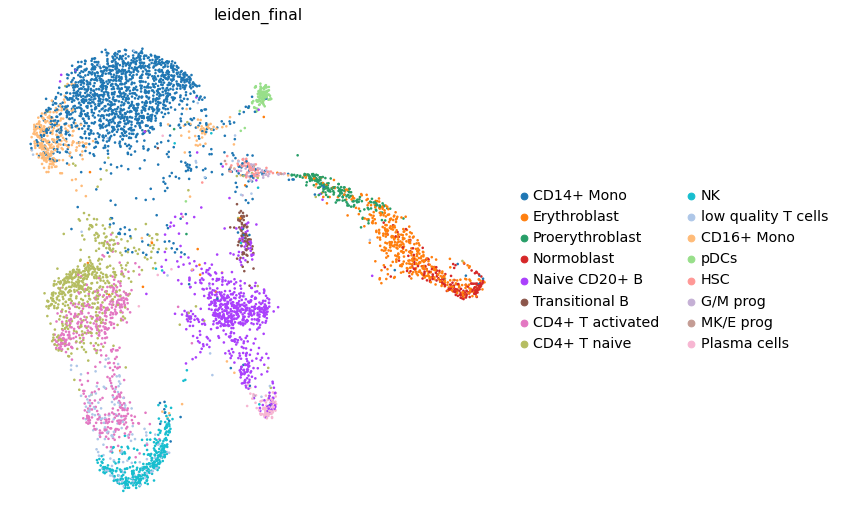

In [136]:
sc.pl.umap(adata_atac_filt, color= ['leiden_final'])

In [137]:
# Updated markes (including new ones for Progenitor clusters)

marker_genes_updated = {
    'CD14+ Mono': ['TREM1', 'FPR1'],
    'CD16+ Mono': ['LYN', 'TCF7L2'],
    'ID2-hi myeloid prog': ['KLF4'],
    'cDC2': ['TREM1', 'DMXL2'], # Note: DMXL2 should be negative
    'Reticulocyte': ['GATA1', 'HBA1', 'SLC4A1', 'SLC25A37', 'KLF1'],
    'Erythroblast': ['GATA1', 'MKI67'],
    'Proerythroblast': ['GATA2', 'SYNGR1'],
    'NK': ['CD160', 'GNLY', 'GRIK4', 'CD247'],
    'ILC': ['SPON2', 'GZMB', 'PRF1'], # Note CD69 should be negative
    'Lymph prog': ['MME', 'IGLL1', 'VPREB1', 'CD79B'],
    'Naive CD20+ B': ['MS4A1', 'LYN', 'CD74', 'BLK'],
    'B1 B': ['ITGB1', 'MS4A1', 'DUSP22', 'EPHA4'],
    'Transitional B': ['MME', 'CD38', 'CD24'],
    'Plasma cells': ['DUSP22', 'FNDC3B'],
    'CD4+ T activated': ['JAKMIP1', 'C4orf50'],
    'CD4+ T naive': [ 'BCL11B', 'BACH2', 'JAKMIP1', 'C4orf50'], # Note JAKMIP1 and C4orf50 are negative markers
    'CD8+ T': ['CD8A', 'CD8B'],
    'pDCs': ['PTPRS', 'TCF4', 'KCNN3', 'DUSP22'],
    'G/M prog': ['MPO', 'NT5DC3'],
    'HSC': ['PRDM16','MTRNR2L1'],
    'MK/E prog': ['DNAJC6'],
    'pro - BORCS5': ['BORCS5', 'RAB31']
}


In [138]:
#Overview
adata_plot = adata_atac_filt.copy()
sc.pp.scale(adata_plot, max_value=4)

Note on marker overview: Compared to the RNA seq markers, the gene activity scores are less distict between clusters. Often markers of multiple subtypes need to be assesed together (E.g.: B1 B and naive CD20+ B cells express very similar set of markers (they are both B cells), but B1 B cells have higher EPHA4 gene activity, therefore distiction can be made)

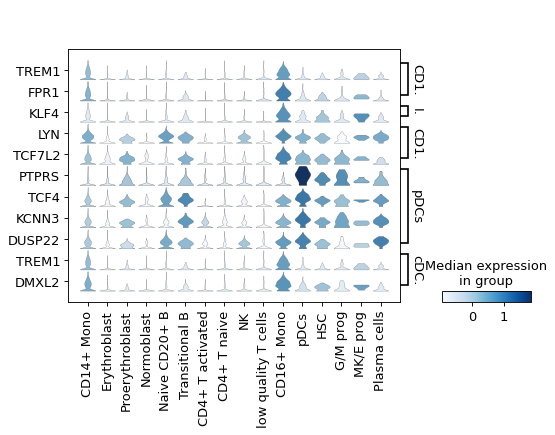

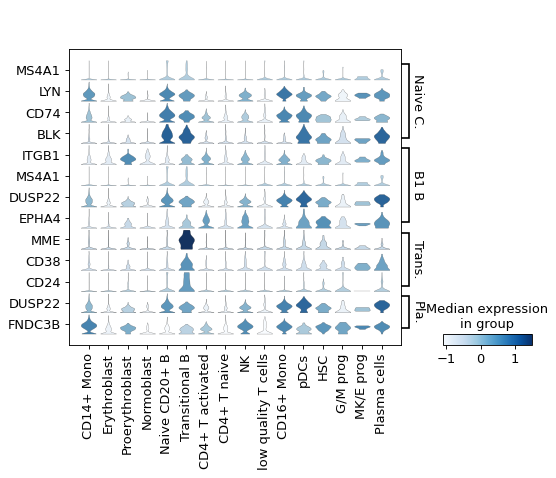

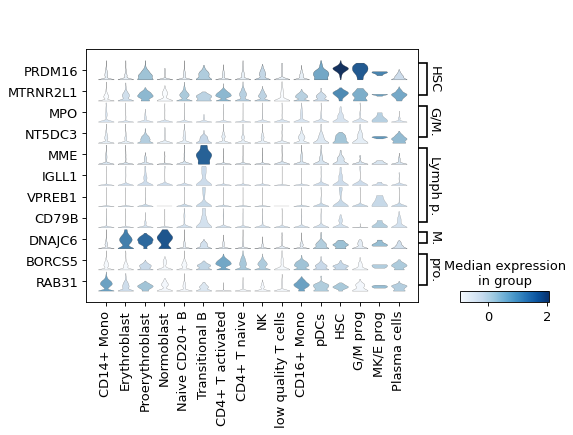

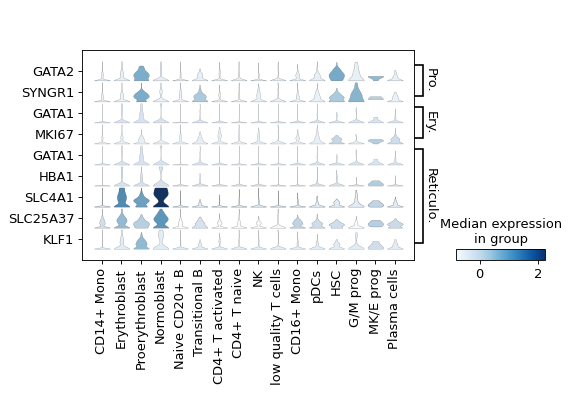

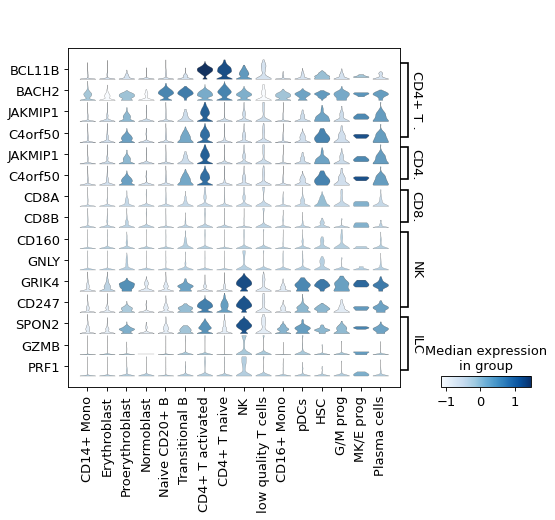

In [139]:
#Monocytes
sc.pl.stacked_violin(adata_plot, groupby='leiden_final', use_raw=False, swap_axes=True,                     
                     var_names={a:marker_genes_updated[a] for a in ['CD14+ Mono', 'ID2-hi myeloid prog', 'CD16+ Mono', 'pDCs', 'cDC2']})

#B cells
sc.pl.stacked_violin(adata_plot, groupby='leiden_final', use_raw=False, swap_axes=True,                     
                     var_names={a:marker_genes_updated[a] for a in ['Naive CD20+ B', 'B1 B', 'Transitional B', 'Plasma cells']})

#Progenitors
sc.pl.stacked_violin(adata_plot, groupby='leiden_final', use_raw=False, swap_axes=True,                     
                     var_names={a:marker_genes_updated[a] for a in ['HSC', 'G/M prog', 'Lymph prog', 'MK/E prog', 'pro - BORCS5']})

#Erythropoiesis
sc.pl.stacked_violin(adata_plot, groupby='leiden_final', use_raw=False, swap_axes=True,                     
                     var_names={a:marker_genes_updated[a] for a in ['Proerythroblast', 'Erythroblast', 'Reticulocyte']})


#T & NK cells
sc.pl.stacked_violin(adata_plot, groupby='leiden_final', use_raw=False, swap_axes=True,                     
                     var_names={a:marker_genes_updated[a] for a in ['CD4+ T naive', 'CD4+ T activated', 'CD8+ T', 'NK', 'ILC']})

## Write output

In [140]:
adata_atac_filt

AnnData object with n_obs × n_vars = 5454 × 19039
    obs: 'nCount_peaks', 'atac_fragments', 'TSS.enrichment', 'reads_in_peaks_frac', 'blacklist_fraction', 'nucleosome_signal', 'leiden_res0.3', 'leiden_res0.5', 'leiden_res0.8', 'leiden_res1', 'leiden_sub', 'leiden_sub2', 'leiden_res0.5_psub1', 'leiden_tsub1', 'leiden_tsub2', 'leiden_nsub', 'leiden_esub', 'leiden_bsub1', 'leiden_bsub2', 'leiden_intermediate1', 'leiden_intermediate2', 'leiden_intermediate3', 'leiden_intermediate4', 'leiden_final'
    uns: 'peak_names', 'neighbors', 'leiden', 'leiden_res0.3_colors', 'leiden_res0.5_colors', 'leiden_res0.8_colors', 'leiden_res1_colors', 'rank_genes_res0.5', 'leiden_sub_colors', 'rg_tsub', 'leiden_sub2_colors', 'rg_tsub2', 'leiden_res0.5_psub1_colors', 'rg_psub1', 'leiden_tsub1_colors', 'rg_tsub1', 'leiden_tsub2_colors', 'leiden_nsub_colors', 'rg_nsub', 'leiden_esub_colors', 'rg_esub', 'leiden_bsub1_colors', 'rg_bsub1', 'leiden_bsub2_colors', 'rg_bsub2', 'leiden_final_colors'
    obsm: 'lsi_

In [141]:
adata_atac_slim = adata_atac_filt.copy()

In [142]:
adata_atac_slim.obs = adata_atac_filt.obs[['nCount_peaks','atac_fragments',
                                     'reads_in_peaks_frac','blacklist_fraction','nucleosome_signal',
                                     'leiden_final']]
del adata_atac_slim.uns
adata_atac_slim.uns['neighbors'] = adata_atac_filt.uns['neighbors']
adata_atac_slim.uns['peak_names'] = adata_atac_filt.uns['peak_names']

In [143]:
adata_atac_slim

AnnData object with n_obs × n_vars = 5454 × 19039
    obs: 'nCount_peaks', 'atac_fragments', 'reads_in_peaks_frac', 'blacklist_fraction', 'nucleosome_signal', 'leiden_final'
    uns: 'neighbors', 'peak_names'
    obsm: 'lsi_full', 'lsi_red', 'peaks', 'umap'
    obsp: 'distances', 'connectivities'

In [144]:
adata_atac_slim.write_h5ad('donor1_atac.h5ad')

In [145]:
adata_atac_slim.obs_names

Index(['AAACAGCCATCCCGCT-1', 'AAACATGCAACAGGTG-1', 'AAACATGCAGTCTAAT-1',
       'AAACATGCAGTCTAGC-1', 'AAACATGCATAGCTGC-1', 'AAACATGCATTAGCCA-1',
       'AAACCAACAACCCTCC-1', 'AAACCAACACATAGCC-1', 'AAACCGAAGGATCCGC-1',
       'AAACCGAAGGCATTAC-1',
       ...
       'TTTGTGAAGTGAGCAA-1', 'TTTGTGAAGTTCCTGC-1', 'TTTGTGAAGTTTAACG-1',
       'TTTGTGGCAATTGCGC-1', 'TTTGTGGCAGCTACGT-1', 'TTTGTGTTCAGCACGC-1',
       'TTTGTGTTCGTTATAG-1', 'TTTGTTGGTCCACAAA-1', 'TTTGTTGGTGAGGTAG-1',
       'TTTGTTGGTTTGGGTA-1'],
      dtype='object', length=5454)